# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
generative_dist = "Diagonal"
learning_rate = 0.003
scheduler_gamma = [0.6, 0.6, 0.5, 0.6, 0.6, 0.5, 0.5]
scheduler_milestones = [25, 50, 100, 150, 200, 250, 400]
use_generative_bias = True

# Use the SummaryModels class
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               scheduler_gamma=scheduler_gamma, scheduler_milestones=scheduler_milestones,
                               use_generative_bias=use_generative_bias)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    df_speed["Type"] = df_speed["Type"].str.replace("Actual", "Actual speed")
    df_course["Type"] = df_course["Type"].str.replace("Actual", "Actual course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


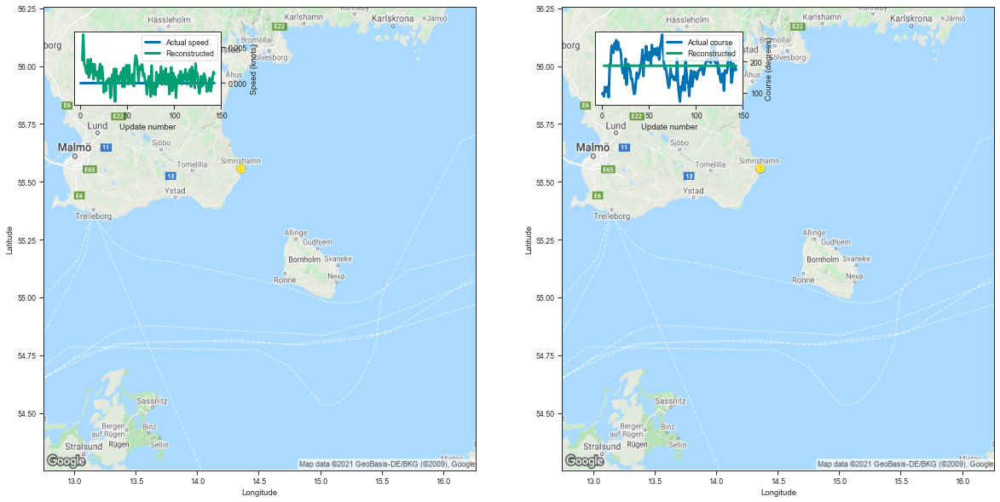

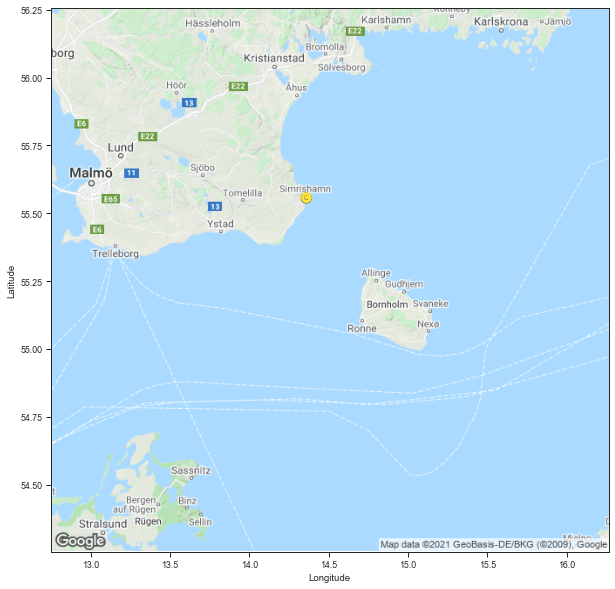

     Data set Index    Index       MMSI  Longitude   Latitude  Speed  \
0                 0  7292936  266054000  14.358107  55.556171    0.0   
1                 0  7292936  266054000  14.358119  55.556152    0.0   
2                 0  7292936  266054000  14.358095  55.556141    0.0   
3                 0  7292936  266054000  14.358088  55.556145    0.0   
4                 0  7292936  266054000  14.358098  55.556149    0.0   
..              ...      ...        ...        ...        ...    ...   
139               0  7292936  266054000  14.358107  55.556156    0.0   
140               0  7292936  266054000  14.358109  55.556152    0.0   
141               0  7292936  266054000  14.358098  55.556156    0.0   
142               0  7292936  266054000  14.358108  55.556164    0.0   
143               0  7292936  266054000  14.358104  55.556156    0.0   

         Course Ship type  Track length          Time stamp  
0     96.363640   Fishing           144 2019-08-22 00:00:03  
1     99.22

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,14.359400,55.556522,0.003155,186.698334,0.001283,0.001262,0.005571,91.719628
3,14.358238,55.557098,0.006764,186.906464,0.001267,0.001152,0.013326,98.086358
4,14.358938,55.558521,0.002639,186.660995,0.000954,0.000889,0.006109,97.979271
5,14.359053,55.558235,0.002350,186.488571,0.000764,0.000720,0.003310,98.201433
6,14.358910,55.558353,0.001561,186.681625,0.000917,0.000840,0.006677,99.444954
...,...,...,...,...,...,...,...,...
139,14.359016,55.558071,-0.001205,186.501053,0.000742,0.000689,0.003412,99.253158
140,14.359047,55.557476,-0.000524,186.520355,0.000762,0.000707,0.003670,99.167777
141,14.359041,55.558235,0.000553,186.594864,0.000832,0.000768,0.004868,99.263764
142,14.359442,55.557457,0.001513,186.601257,0.000840,0.000775,0.005002,99.265791


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


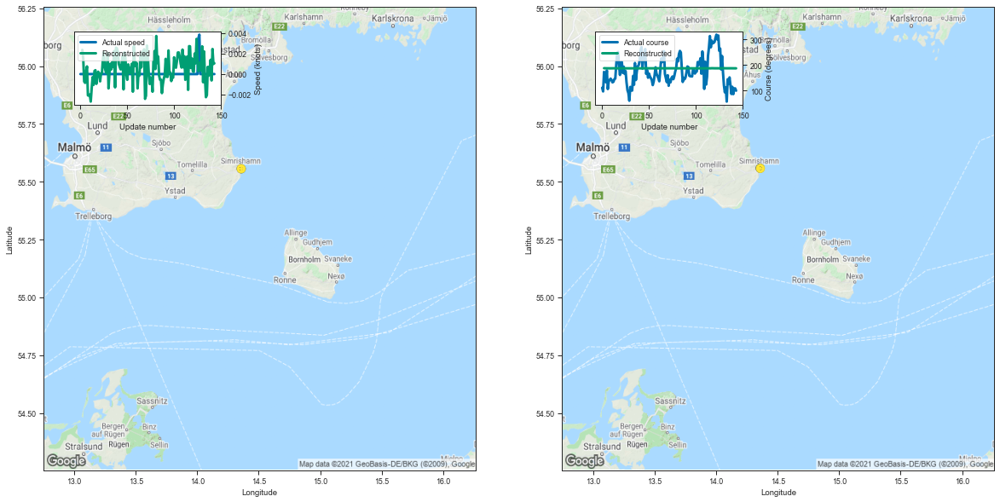

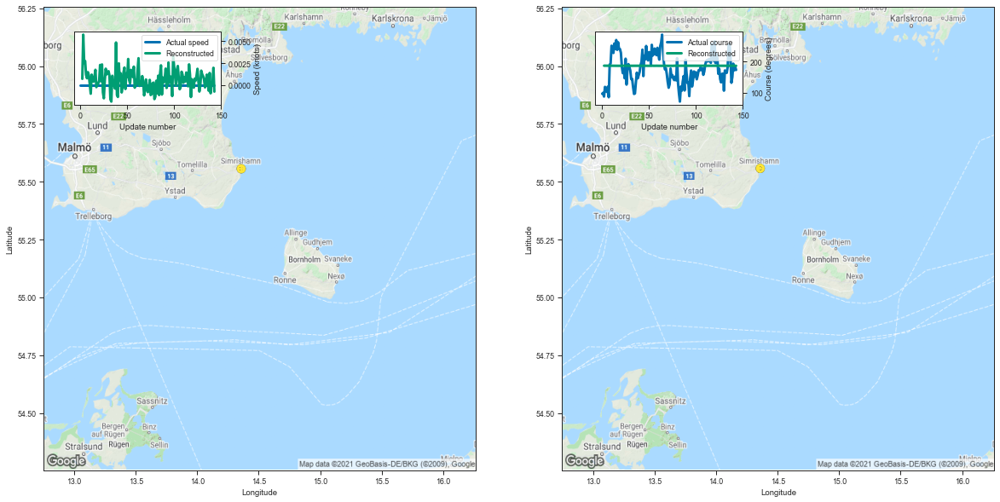

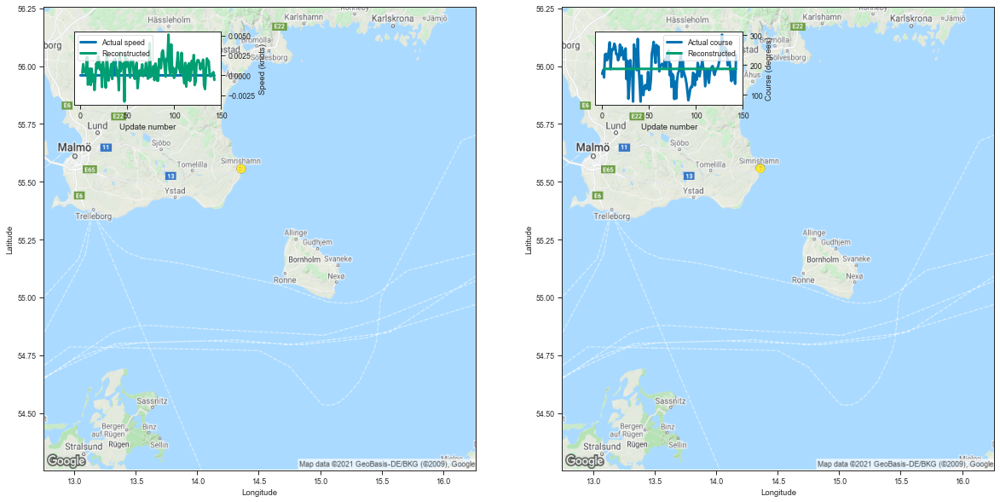

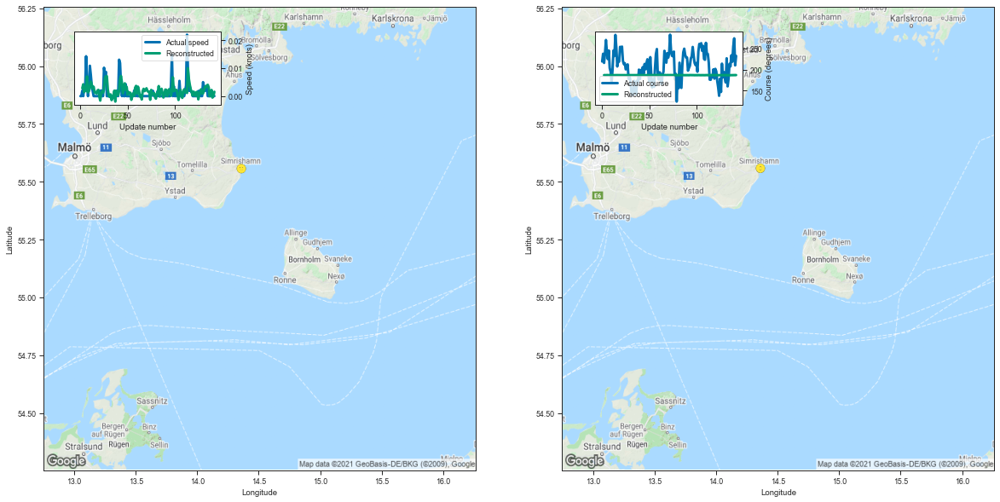

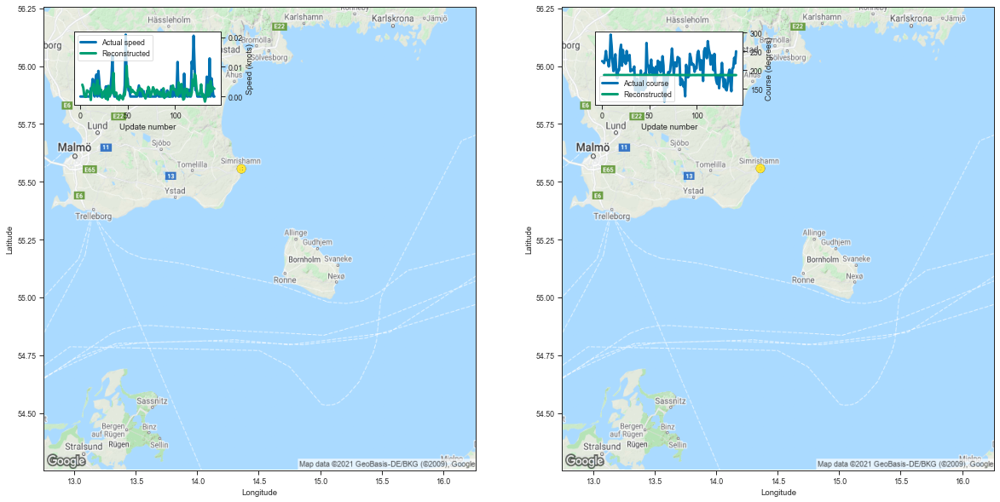

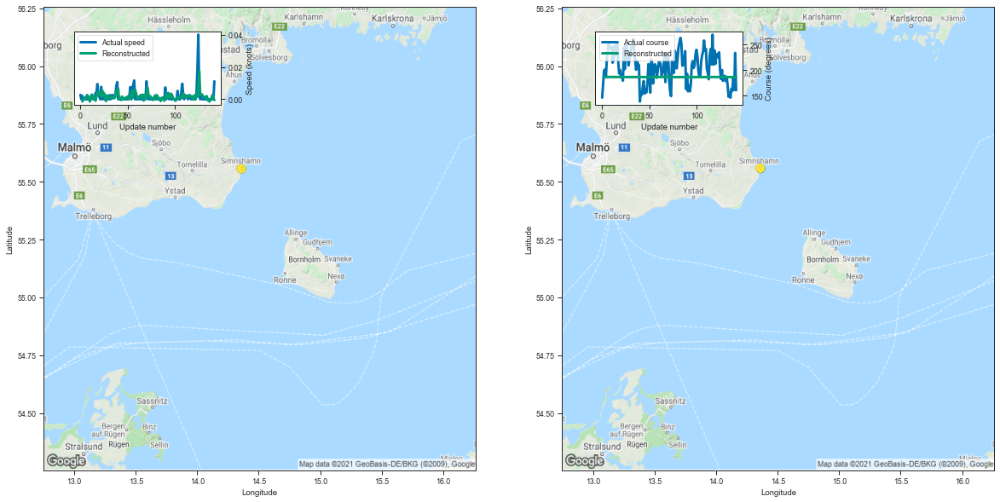

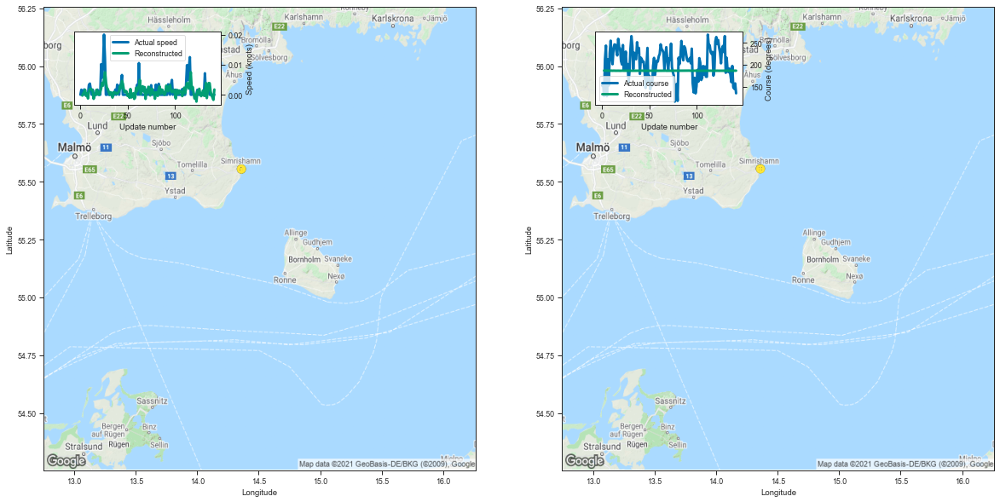

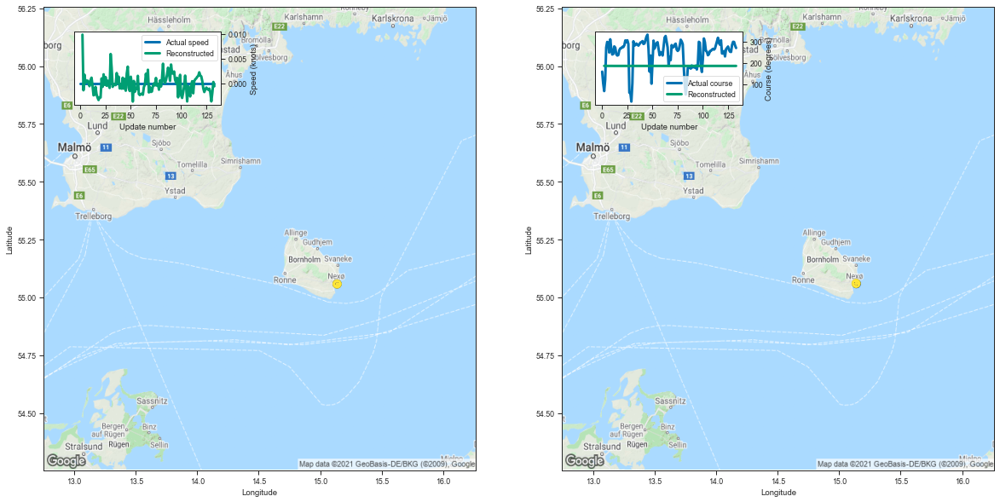

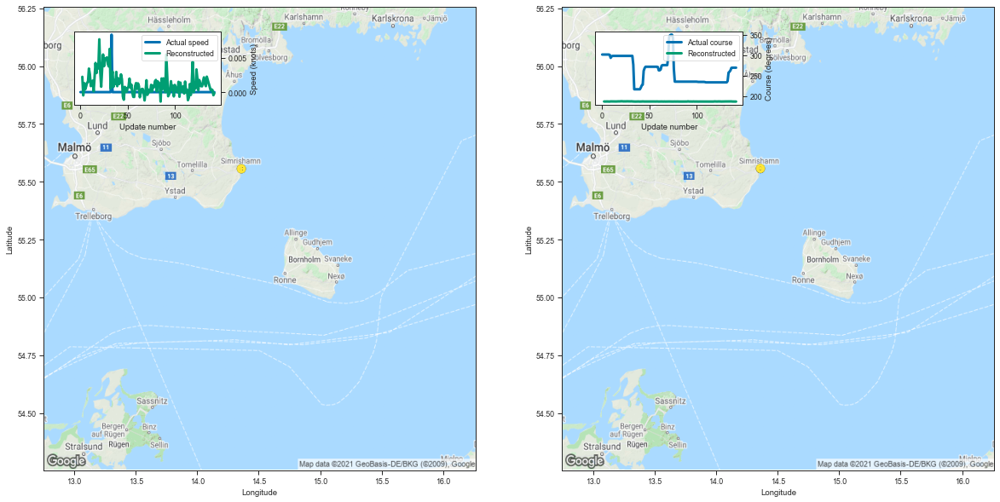

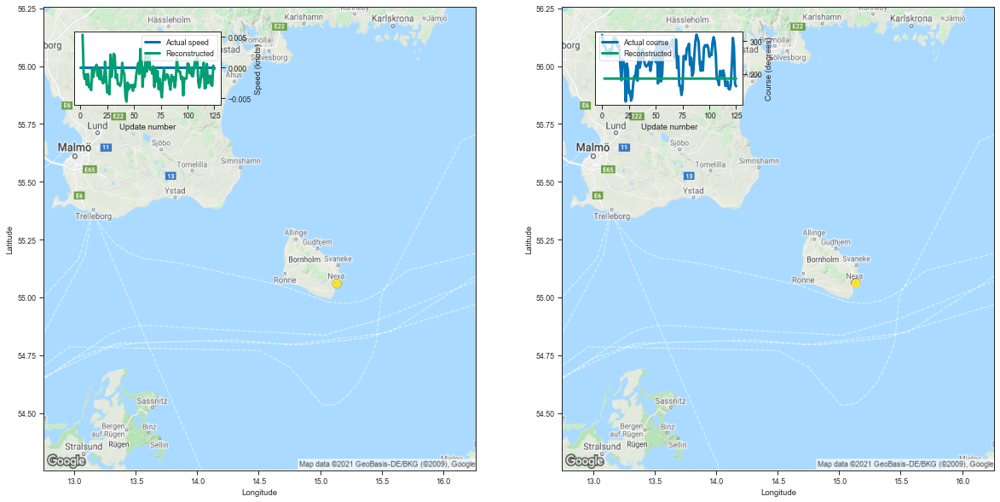

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
34,34,7237328,266054000,Fishing,144,1350.966309,9.381710
25,25,7292936,266054000,Fishing,144,1349.198364,9.369433
44,44,7135380,266054000,Fishing,144,1325.994385,9.208294
17,17,6685896,265759000,Fishing,143,1296.819336,9.068667
29,29,6787151,265759000,Fishing,143,1281.349854,8.960488
60,60,6869996,265759000,Fishing,143,1280.683960,8.955832
74,74,6962046,265759000,Fishing,143,1264.291260,8.841198
109,109,609266,211474000,Fishing,134,1167.505249,8.712726
103,103,6064863,265754000,Fishing,143,1243.158813,8.693418
110,110,155071,211314800,Fishing,126,1088.322998,8.637484


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


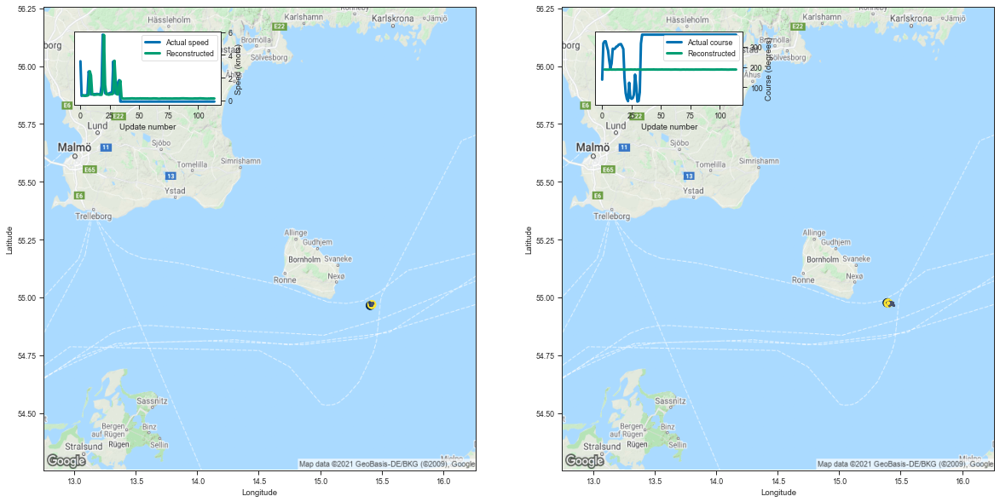

[0.4422088861465454, 0.41762423515319824, 0.39789605140686035, 0.4162236452102661]


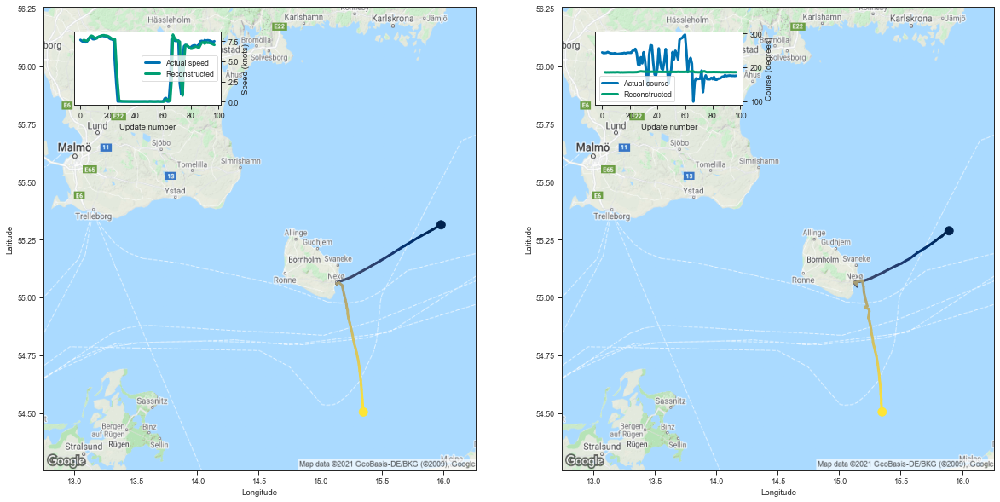

[7.628657341003418, 7.623791694641113, 7.544806480407715, 7.570728302001953]


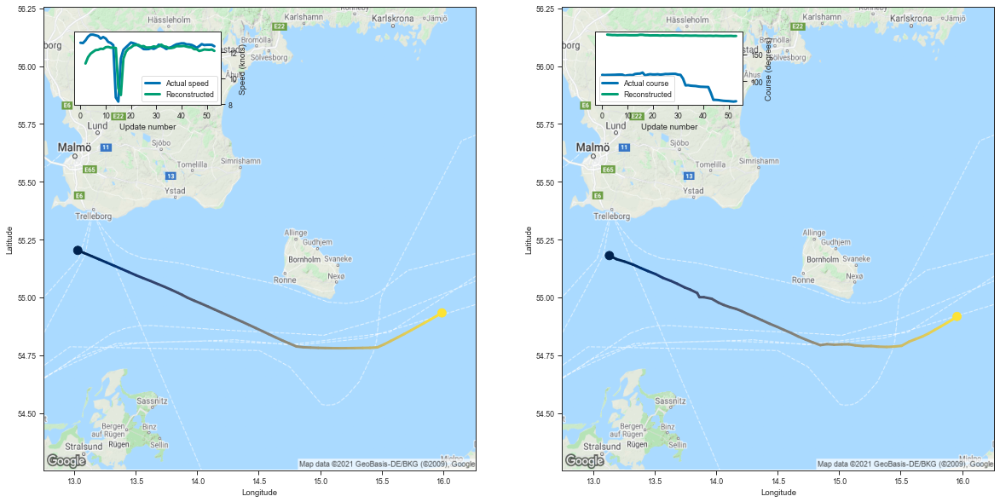

[11.119941711425781, 11.603107452392578, 11.869556427001953, 12.018411636352539]


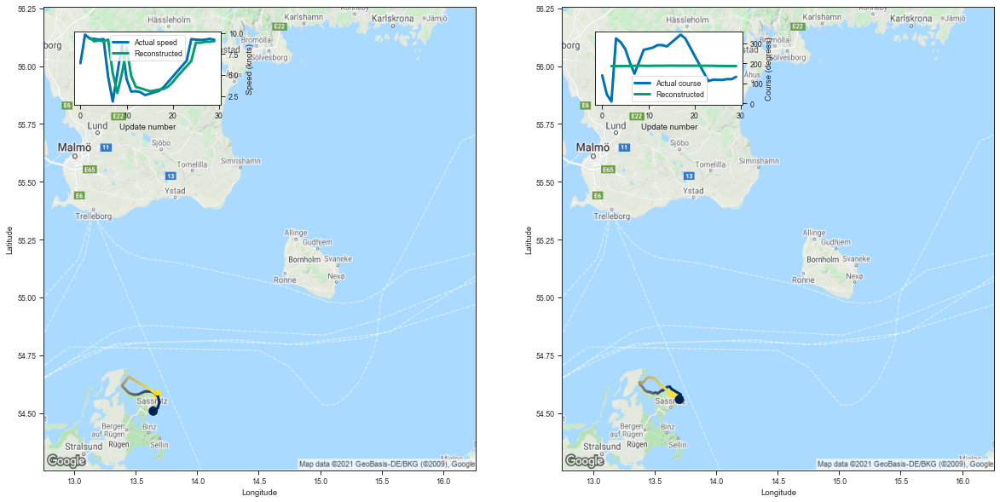

[9.411383628845215, 8.998550415039062, 9.103626251220703, 9.016956329345703]


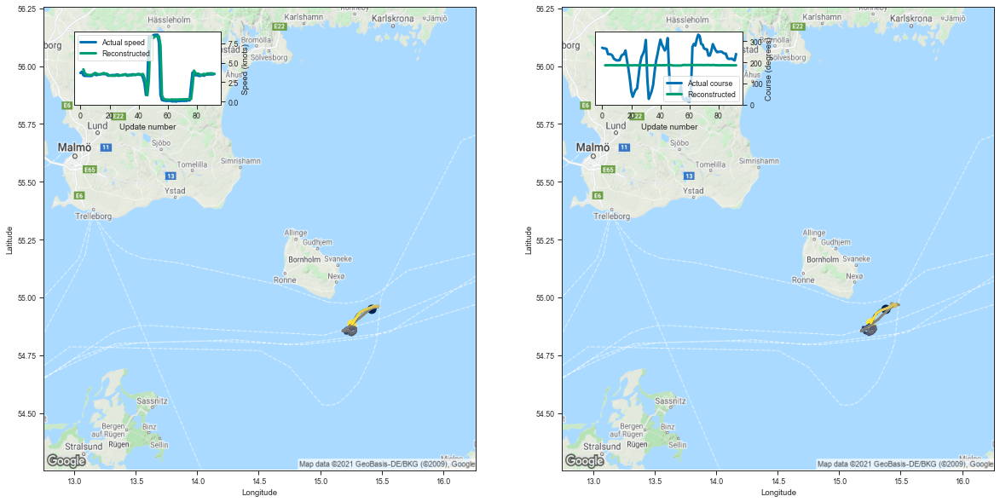

[4.163976669311523, 3.652204990386963, 3.508115768432617, 3.451714038848877]


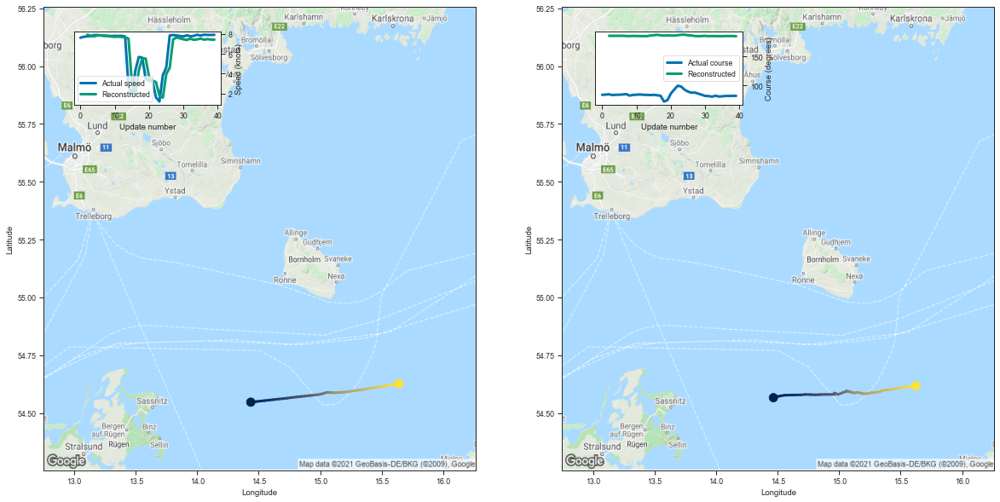

[7.937000274658203, 7.818863391876221, 7.766505718231201, 7.849218368530273]


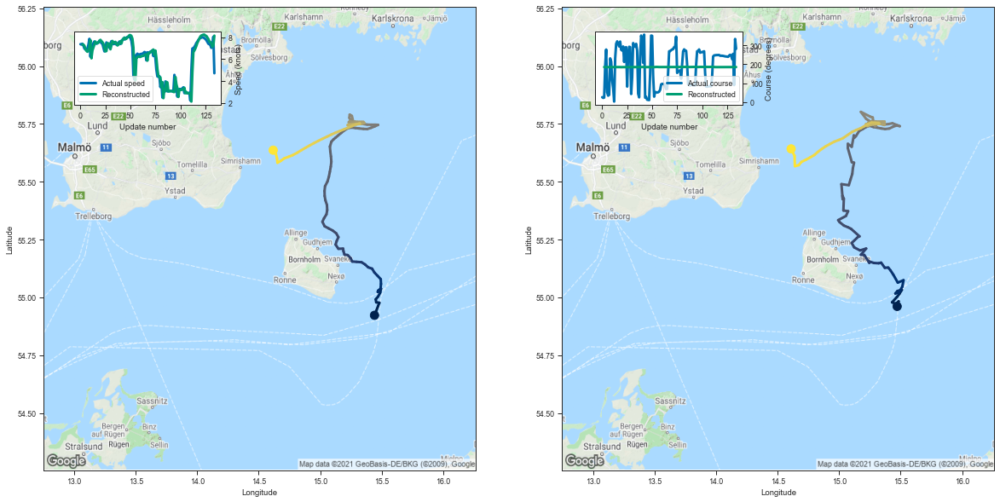

[7.341988563537598, 7.325069904327393, 7.20651912689209, 6.934200286865234]


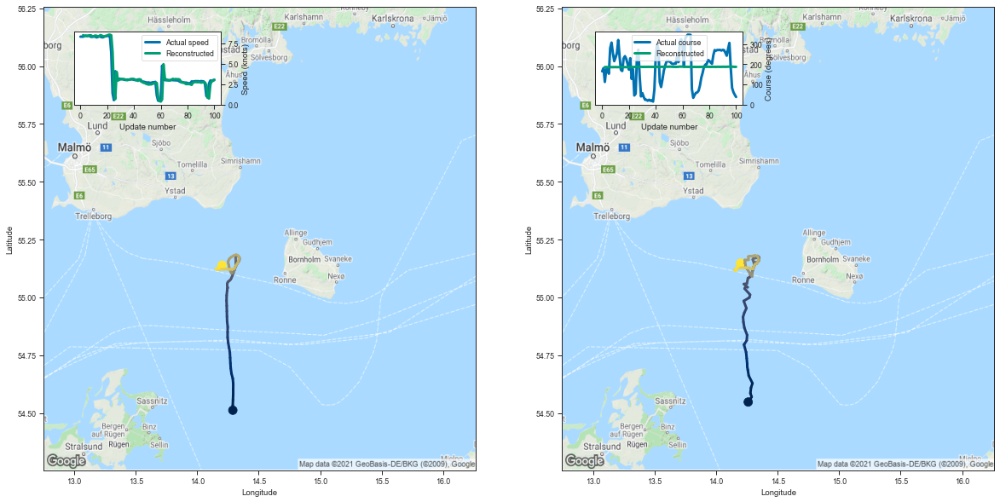

[8.502023696899414, 8.381200790405273, 8.428237915039062, 8.421825408935547]


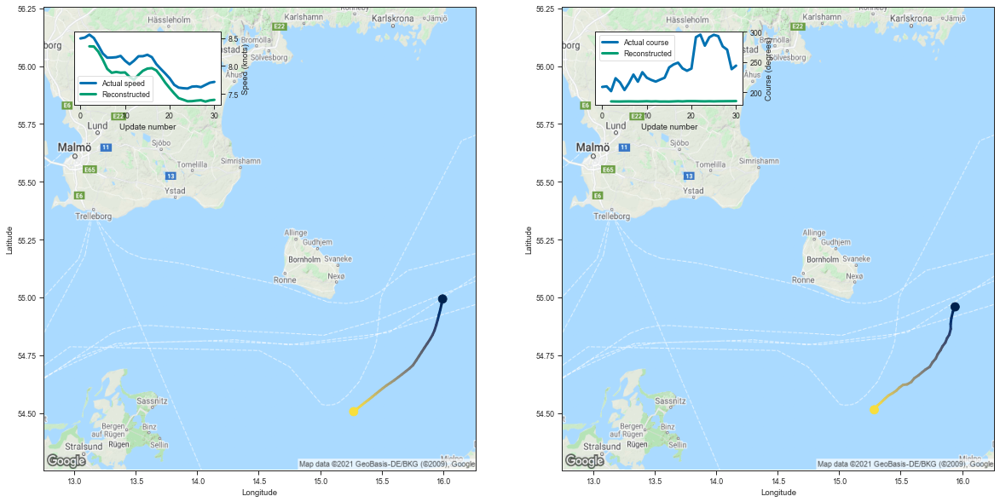

[8.351698875427246, 8.348527908325195, 8.257434844970703, 8.114465713500977]


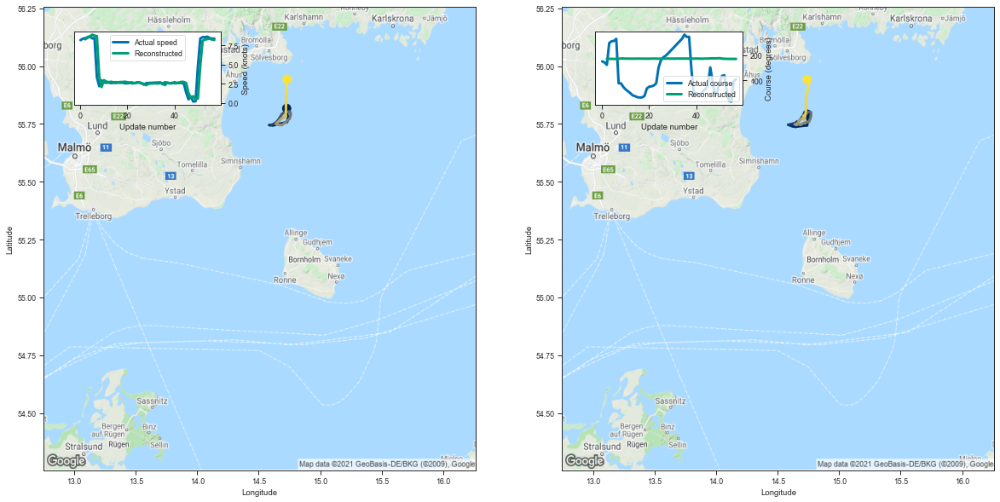

[8.256738662719727, 8.453352928161621, 8.631473541259766, 8.871101379394531]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
56,56,4380691,261017210,Fishing,115,-718.239441,-6.245560
105,105,4108573,261004260,Fishing,98,-511.176208,-5.216084
36,36,7969192,273352230,Fishing,54,-145.317993,-2.691074
73,73,1113112,211542610,Fishing,30,-80.634216,-2.687807
78,78,140882,211314800,Fishing,93,-240.891769,-2.590234
67,67,1070020,211474000,Fishing,40,-81.217308,-2.030433
49,49,1557318,219021428,Fishing,135,-255.680679,-1.893931
48,48,4303656,261007170,Fishing,101,-146.598343,-1.451469
1,1,4547326,261061000,Fishing,31,-43.411766,-1.400380
38,38,4942336,265593190,Fishing,58,-58.244545,-1.004216


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_GBT_lr0003_S2550100150200250400_06060506060505.pth


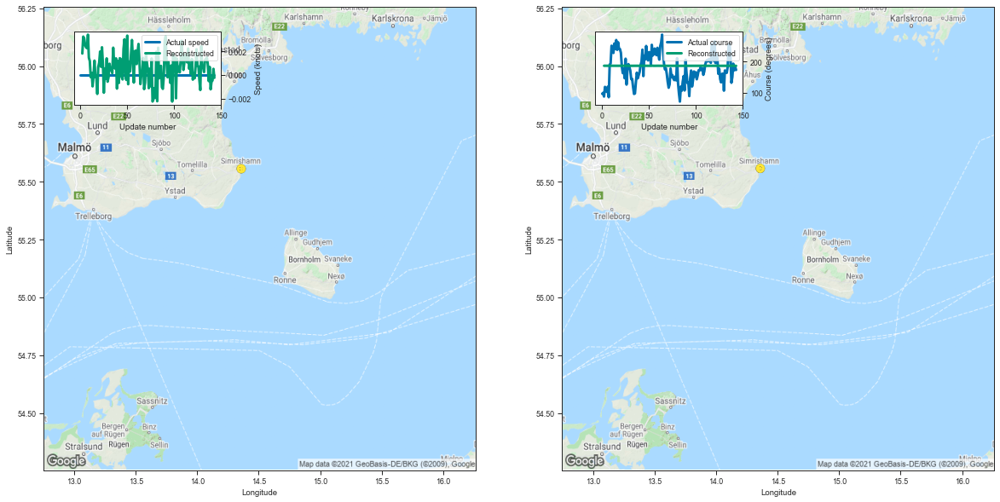

[0.001804351806640625, 0.0032269954681396484, 0.003071308135986328, 0.0025005340576171875]


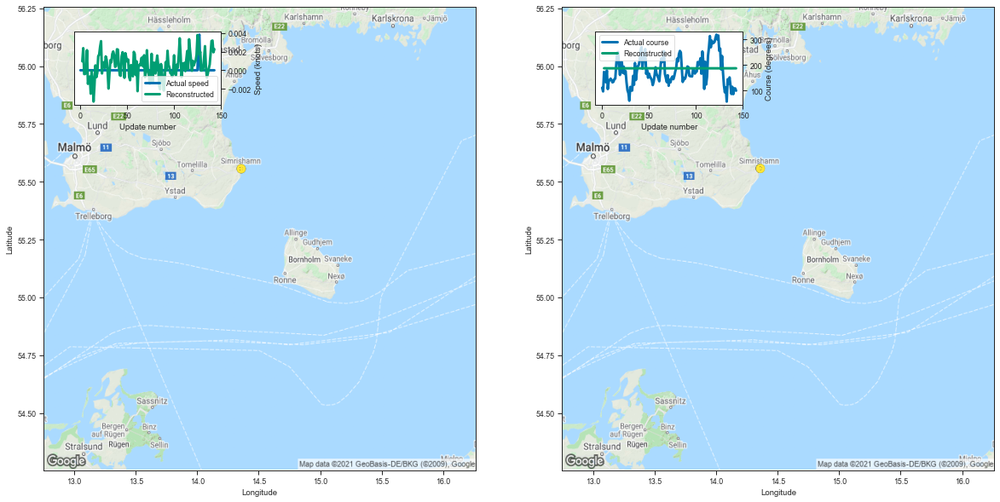

[0.0009660720825195312, 0.002384185791015625, -0.0004096031188964844, -0.00039839744567871094]


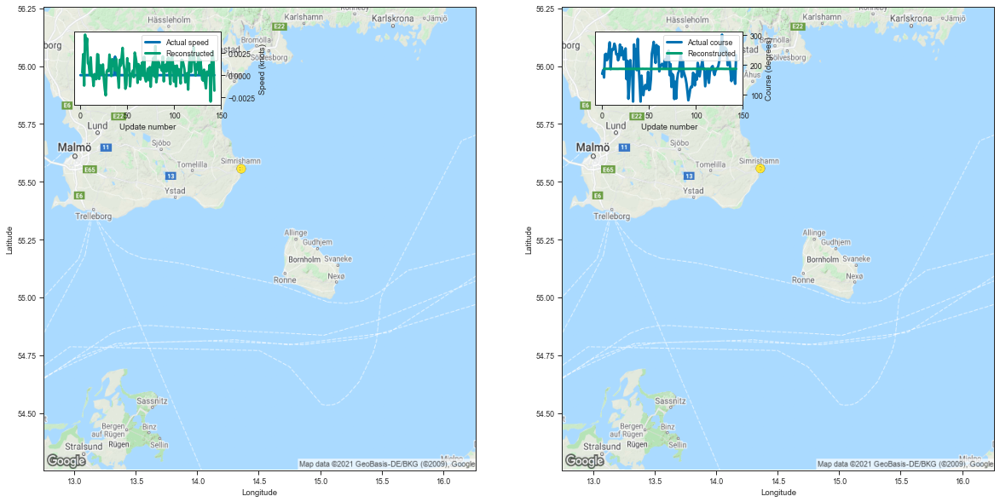

[0.0002865791320800781, 0.0023577213287353516, -0.0011701583862304688, 0.004559040069580078]


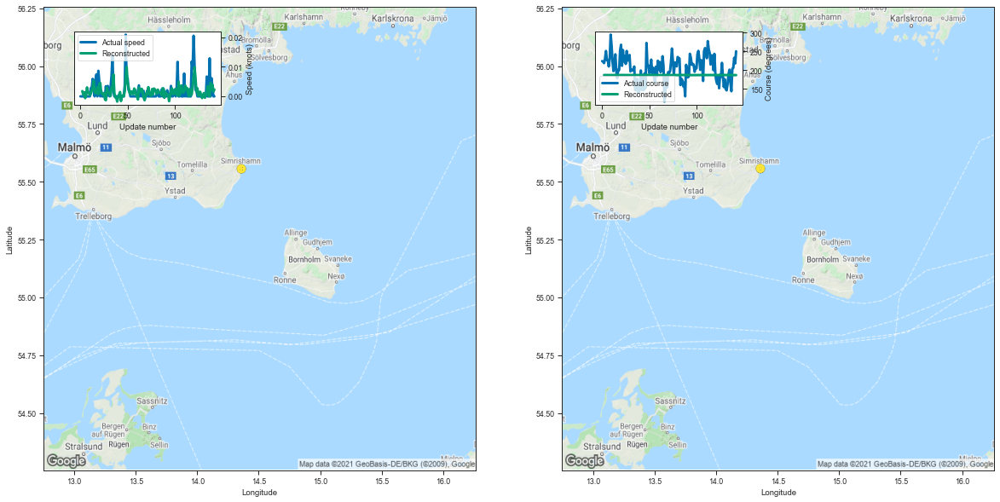

[0.0017633438110351562, 0.0005702972412109375, 0.0013995170593261719, -0.0005993843078613281]


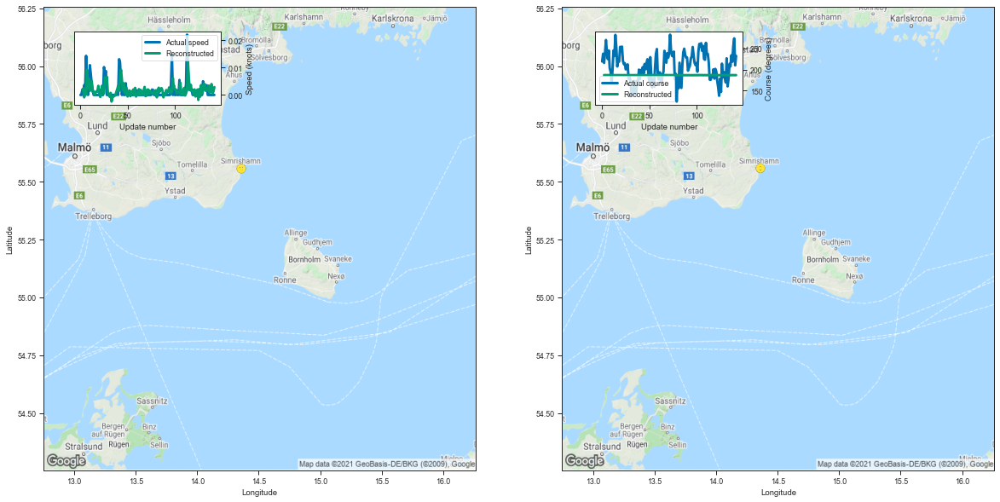

[0.0018303394317626953, 0.0023539066314697266, -0.0008778572082519531, 0.0023488998413085938]


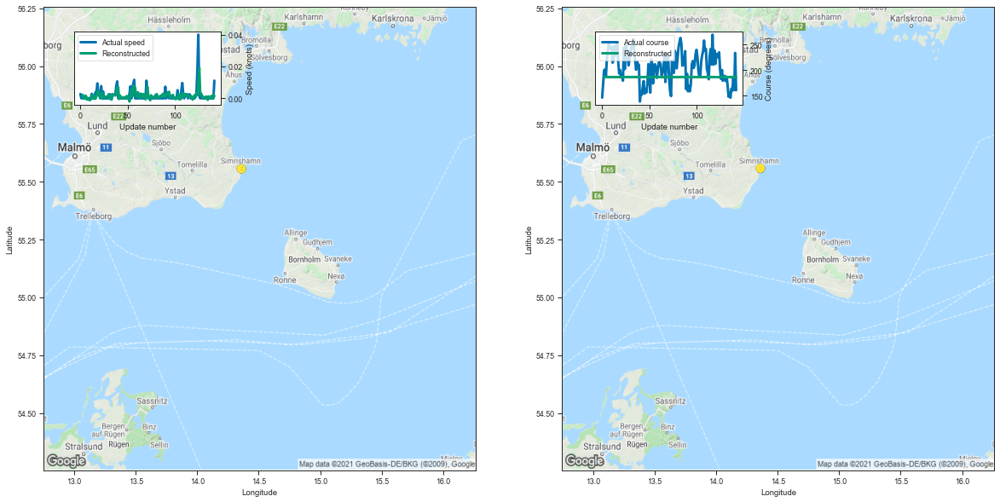

[0.002299785614013672, 8.20159912109375e-05, -0.0002079010009765625, 0.0017251968383789062]


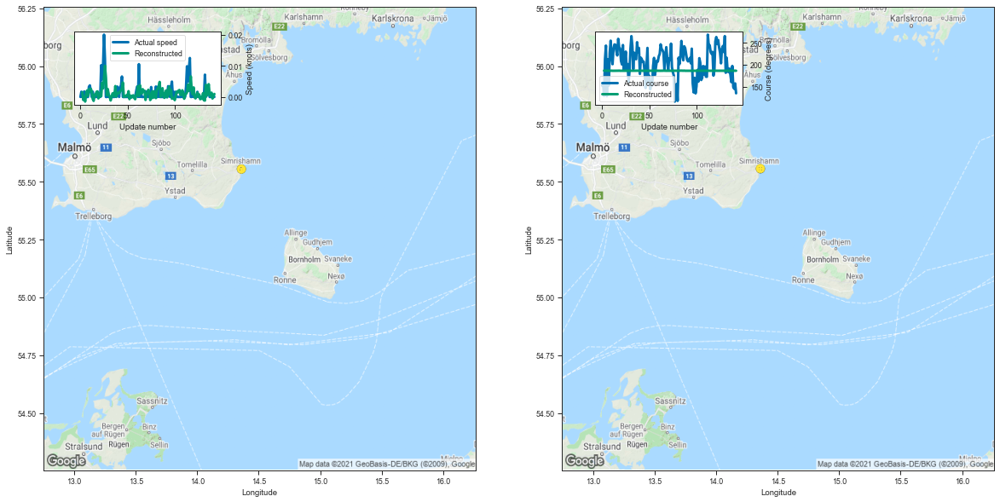

[0.0015139579772949219, -0.0009760856628417969, -1.430511474609375e-05, -0.001485586166381836]


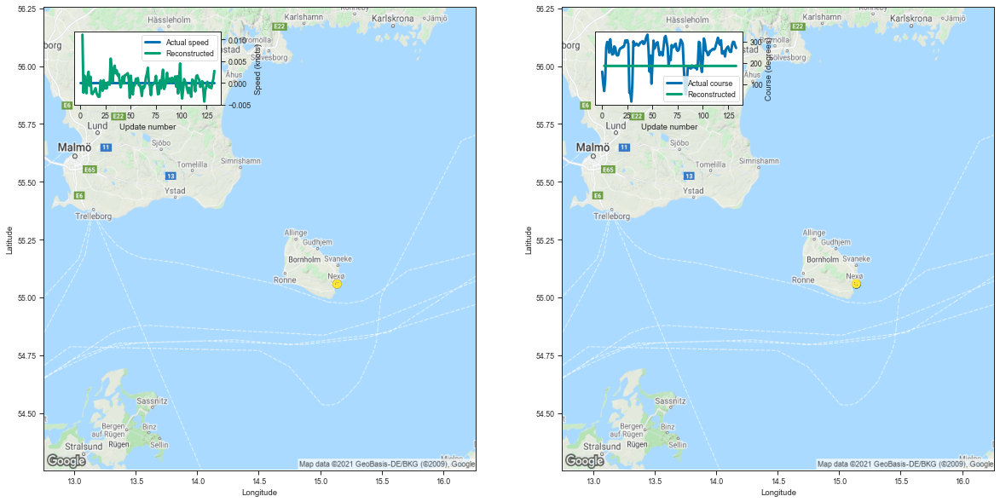

[0.011065483093261719, -0.0022788047790527344, 0.0016415119171142578, -4.00543212890625e-05]


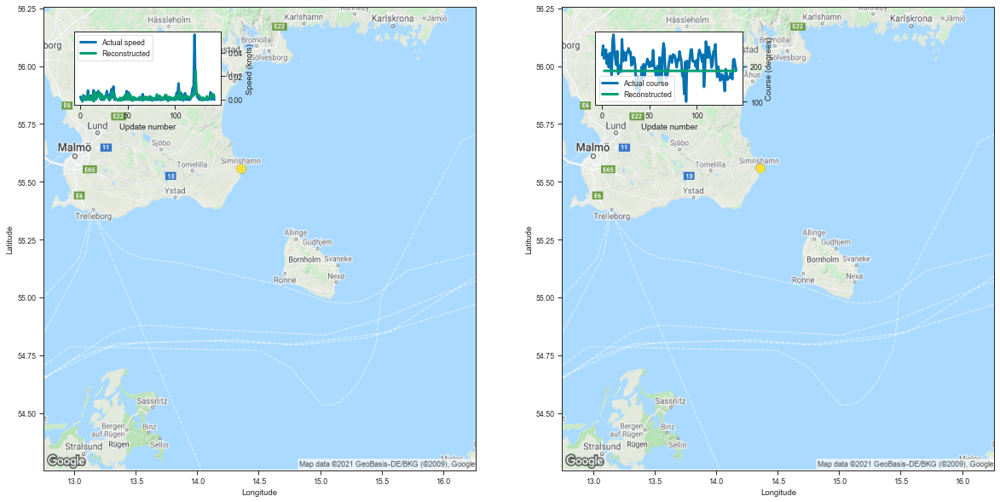

[-0.0016200542449951172, 0.003765583038330078, 0.0027446746826171875, 0.0028405189514160156]


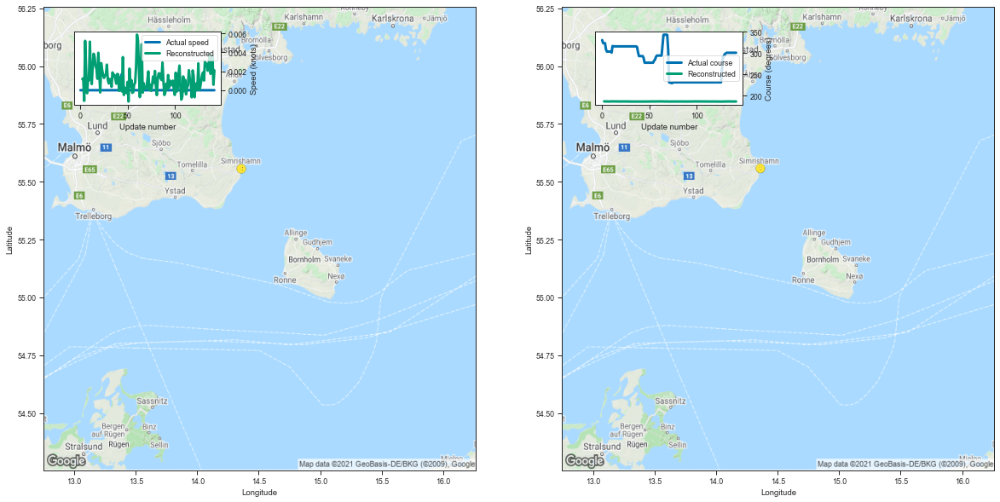

[0.0011801719665527344, 0.0012464523315429688, -0.0011229515075683594, 0.0052089691162109375]


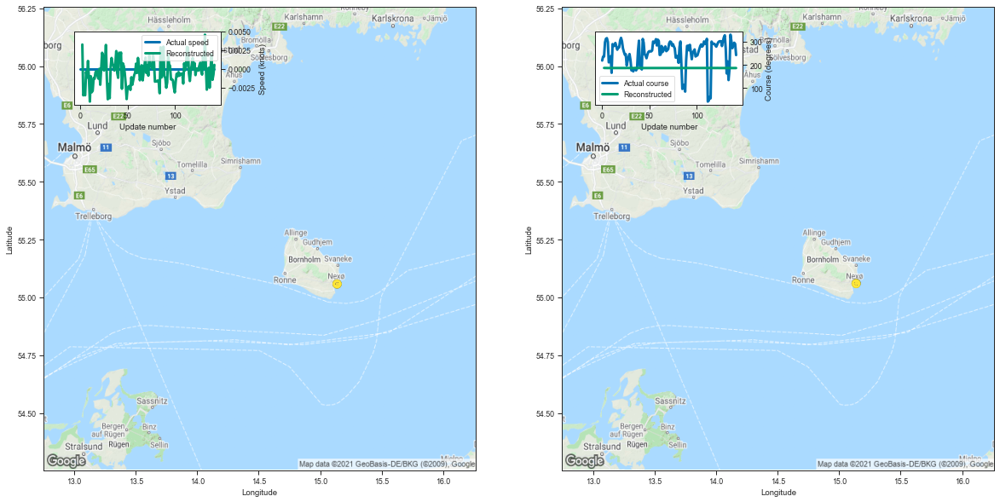

[0.003239154815673828, -0.0035614967346191406, -0.0033292770385742188, -0.0035543441772460938]


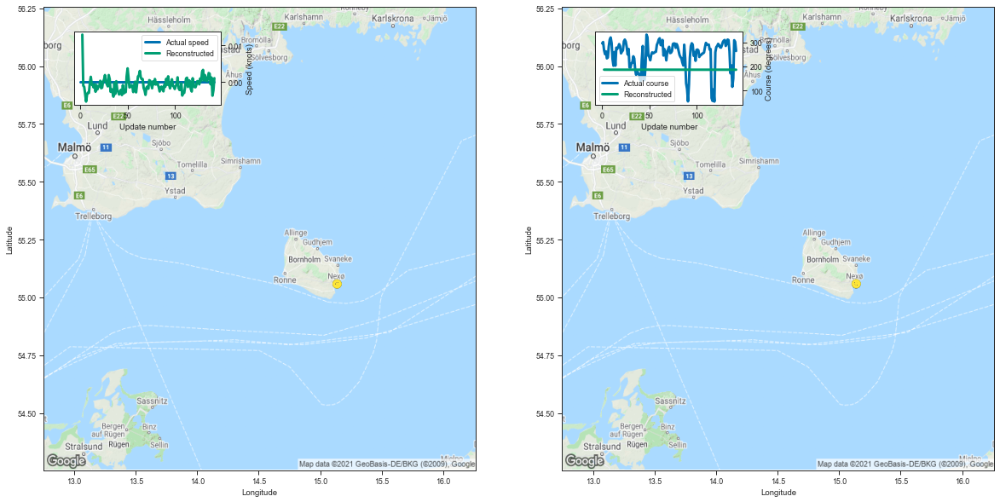

[0.012989997863769531, -0.0009522438049316406, -0.0013022422790527344, -0.0031995773315429688]


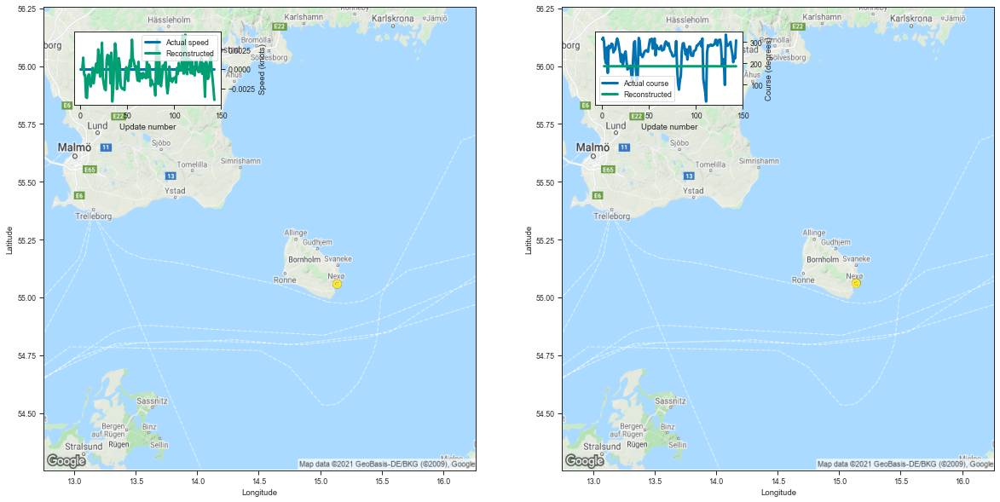

[2.4318695068359375e-05, 0.0014643669128417969, -0.0007503032684326172, -0.0007765293121337891]


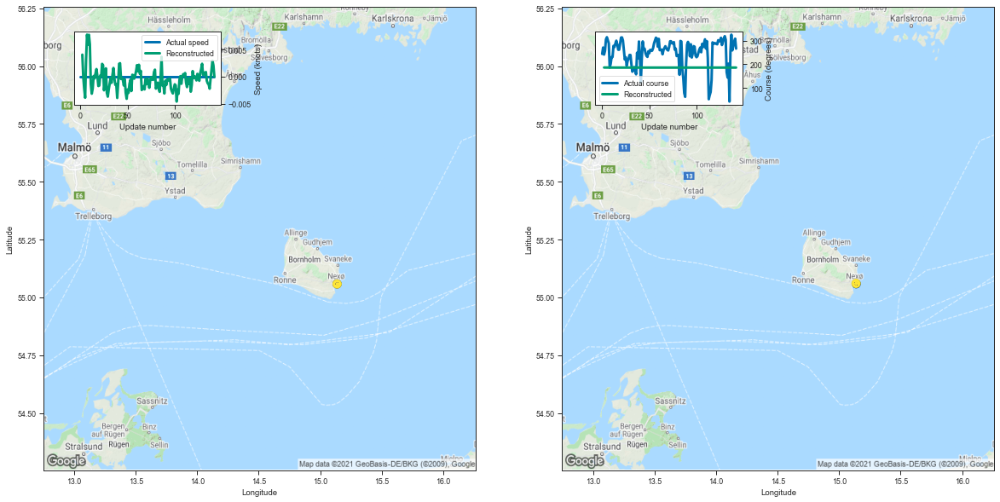

[0.004072666168212891, -1.3589859008789062e-05, -0.002206087112426758, -0.003881692886352539]


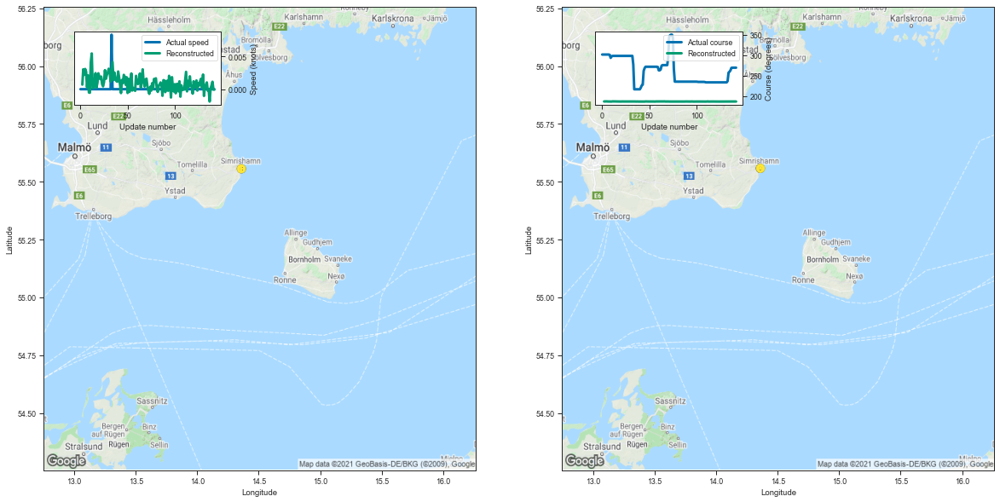

[0.0006999969482421875, 0.0030412673950195312, 0.0021953582763671875, 0.0030841827392578125]


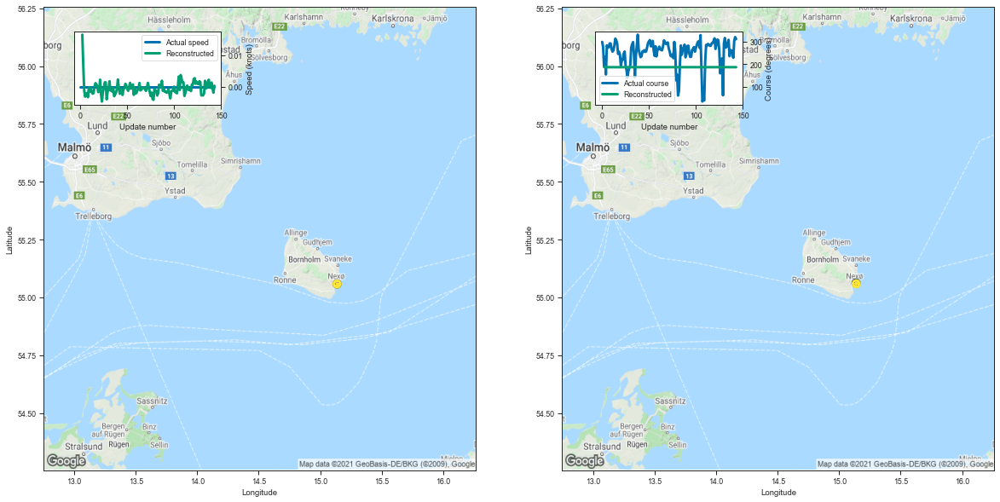

[0.016475200653076172, 0.0070645809173583984, -0.0009875297546386719, -0.003086090087890625]


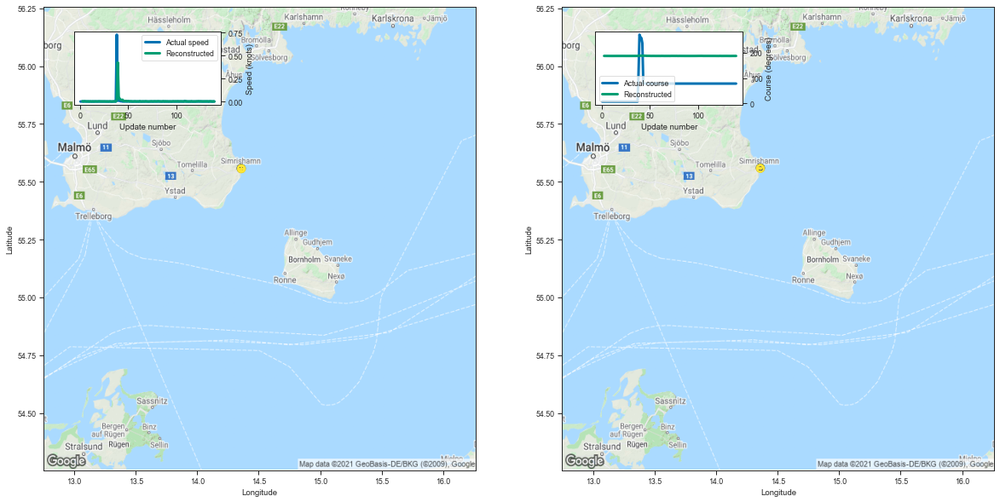

[0.003540515899658203, 0.0009036064147949219, 0.0037870407104492188, 0.0027213096618652344]


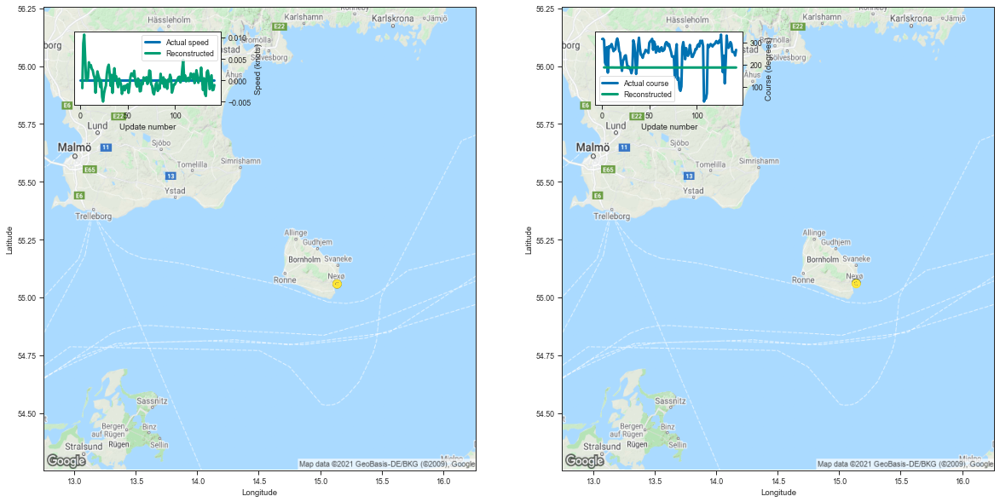

[-0.0018095970153808594, 0.008587837219238281, 0.010643720626831055, 0.005490303039550781]


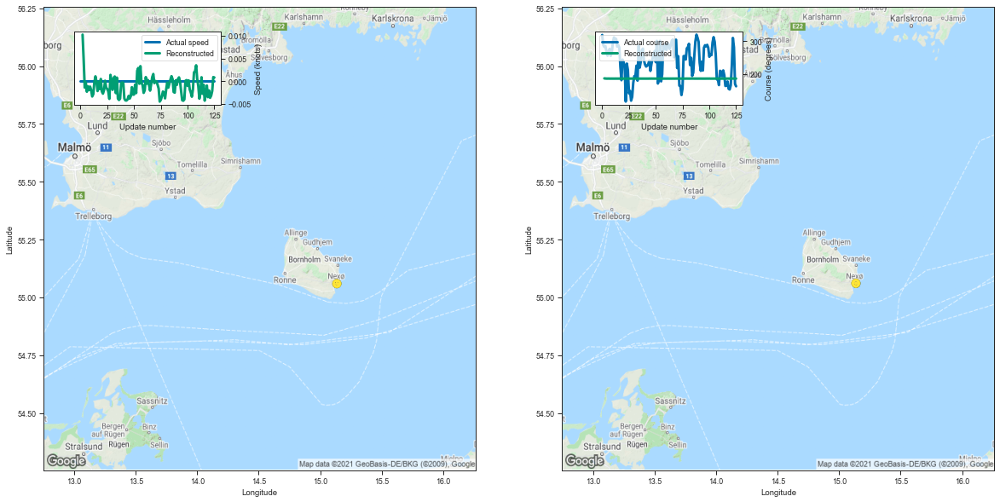

[0.010263442993164062, 0.004783153533935547, -0.0014233589172363281, -0.00024771690368652344]


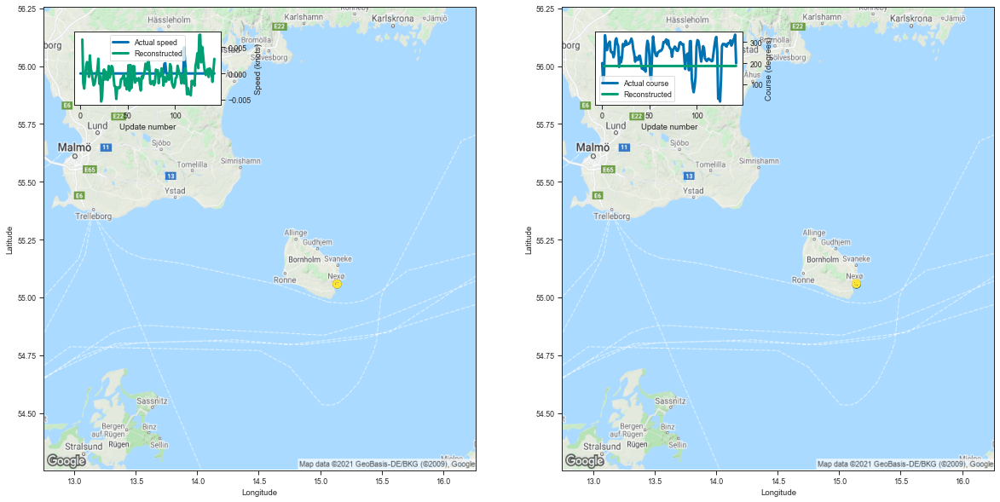

[0.00648045539855957, -0.001861572265625, -0.0028886795043945312, -0.0007228851318359375]


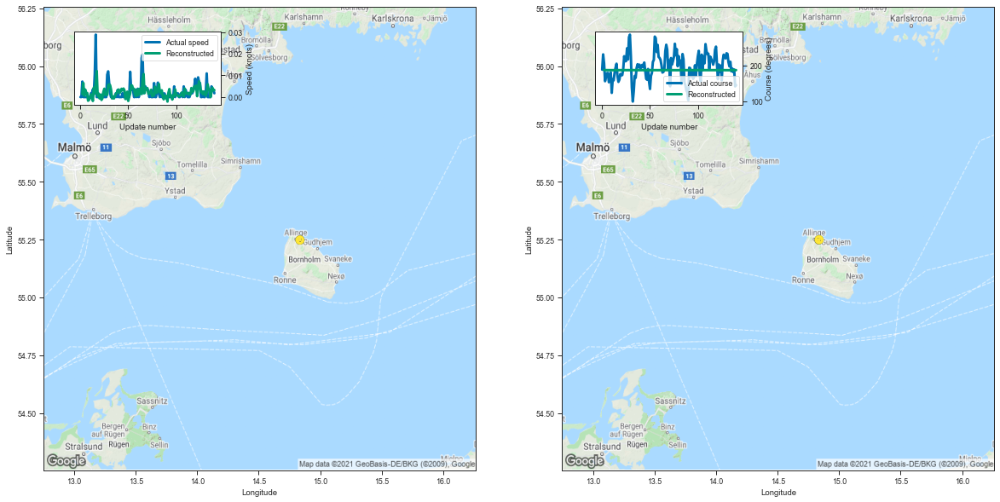

[0.001398324966430664, 0.006470680236816406, 0.0006227493286132812, 0.0034623146057128906]


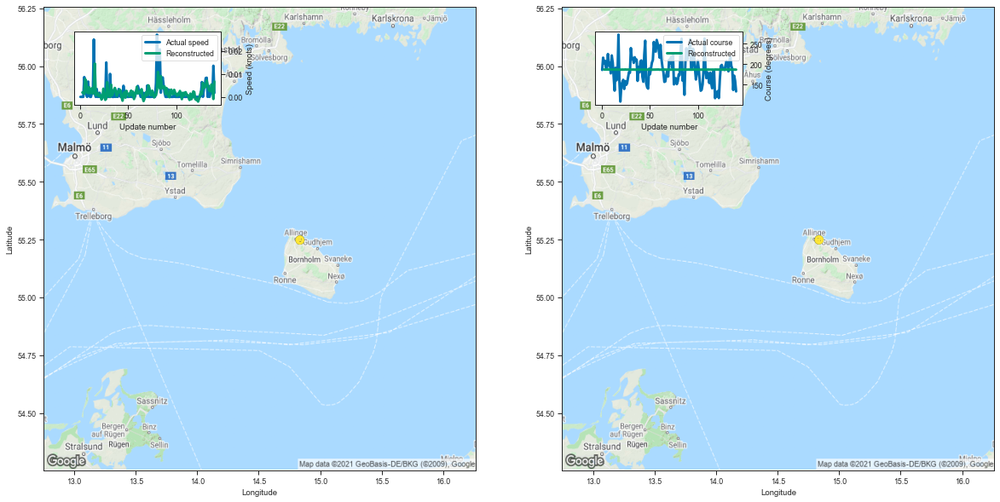

[0.0019164085388183594, 0.0020313262939453125, 0.001291513442993164, 0.007720470428466797]


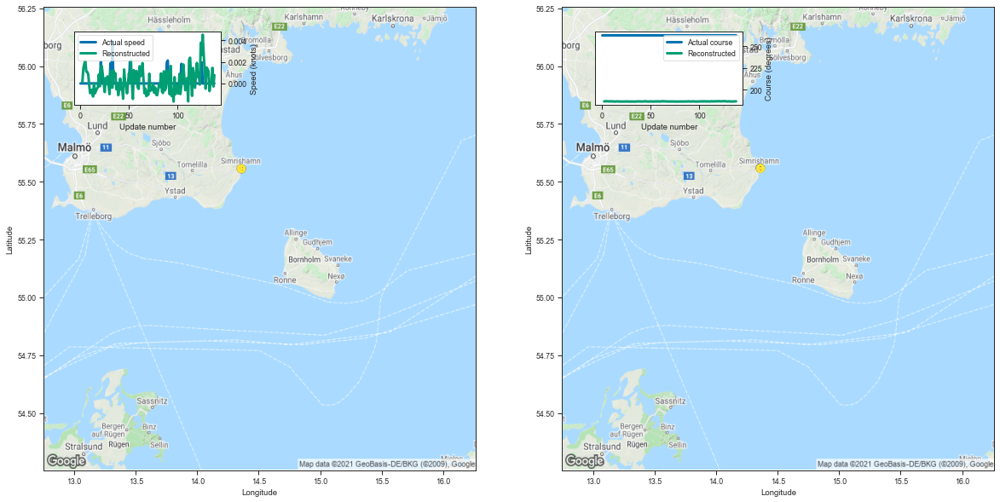

[0.00010728836059570312, 0.001384735107421875, 0.0018134117126464844, 0.0020821094512939453]


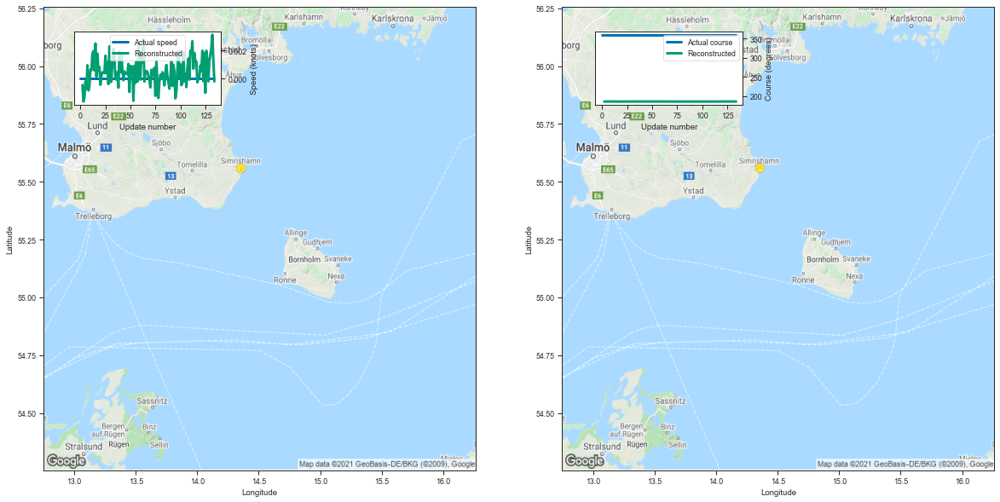

[-0.0004515647888183594, -0.0016231536865234375, -0.0013403892517089844, -0.00019407272338867188]


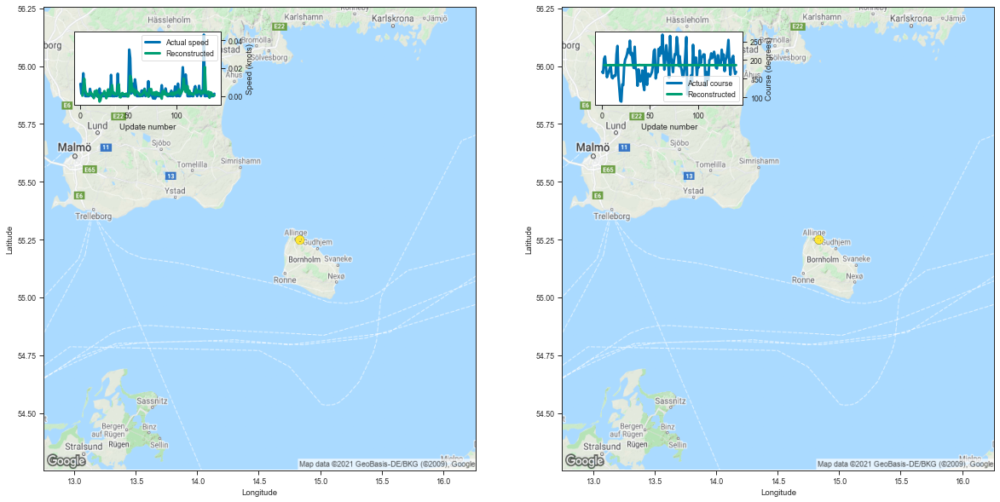

[0.00029659271240234375, 0.006173133850097656, 0.012413263320922852, 0.004148960113525391]


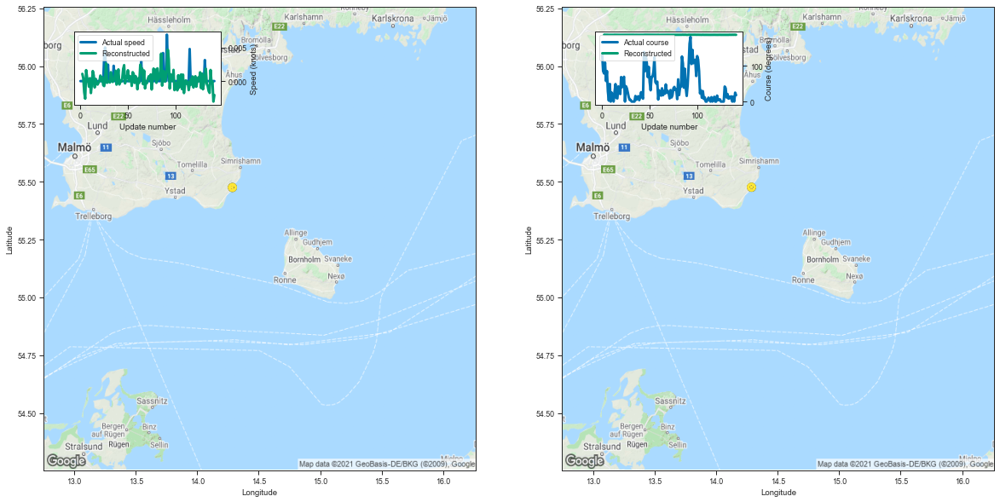

[0.00107574462890625, 0.0004379749298095703, -0.0016491413116455078, -0.002608776092529297]


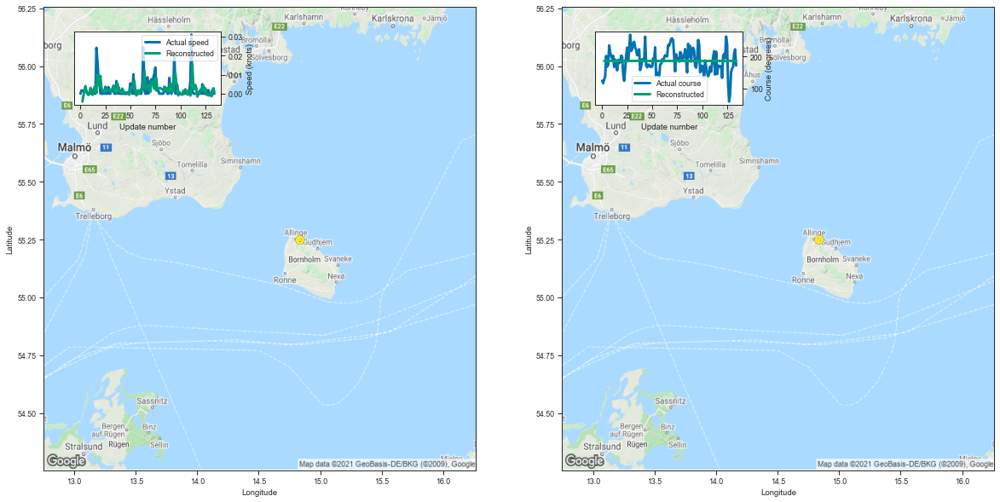

[-0.004133701324462891, -0.0009102821350097656, 0.0016994476318359375, 0.003971099853515625]


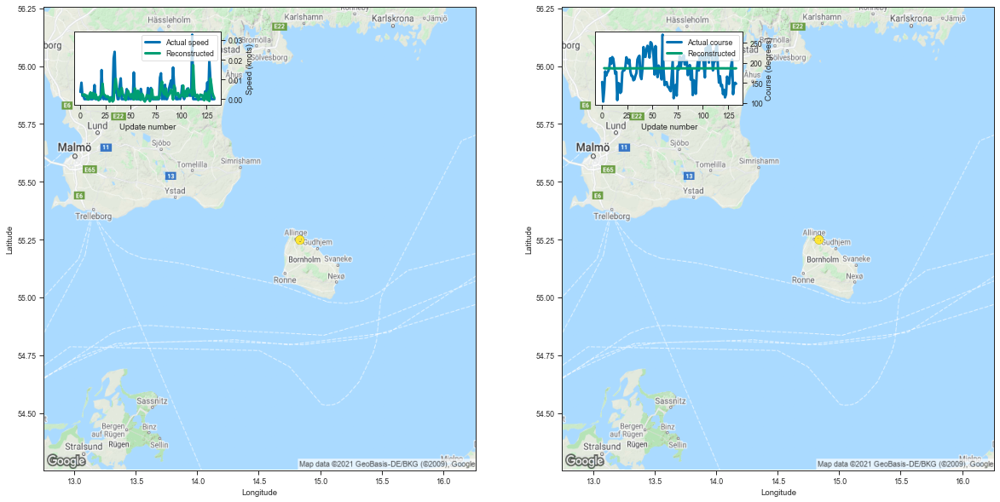

[0.002393484115600586, 0.0018572807312011719, 0.002425670623779297, 0.00145721435546875]


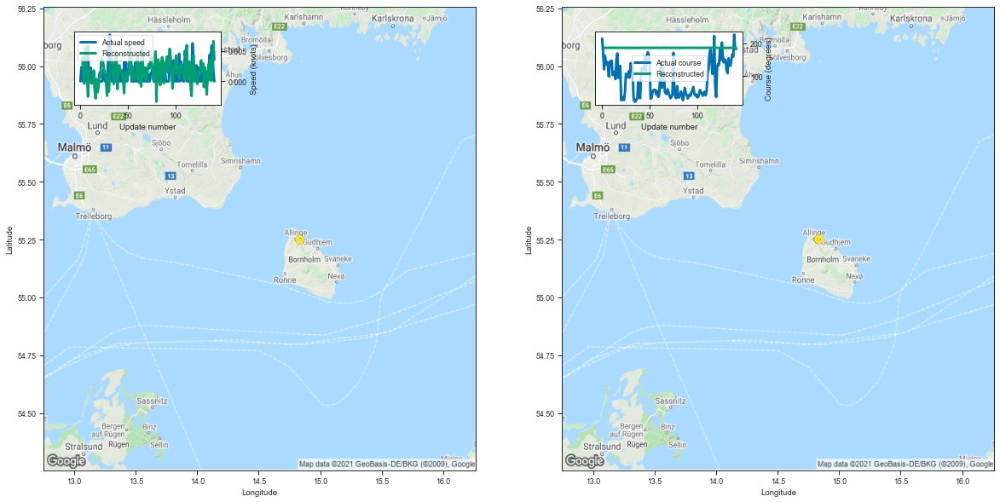

[0.003858327865600586, 0.0014901161193847656, -0.0003800392150878906, 0.005602836608886719]


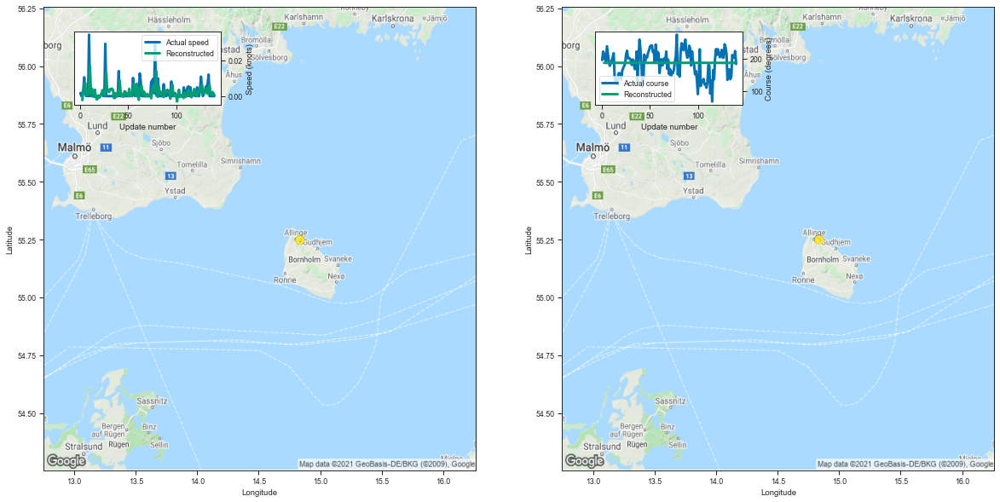

[-0.002271890640258789, 0.0033452510833740234, 0.004411220550537109, 0.007367610931396484]


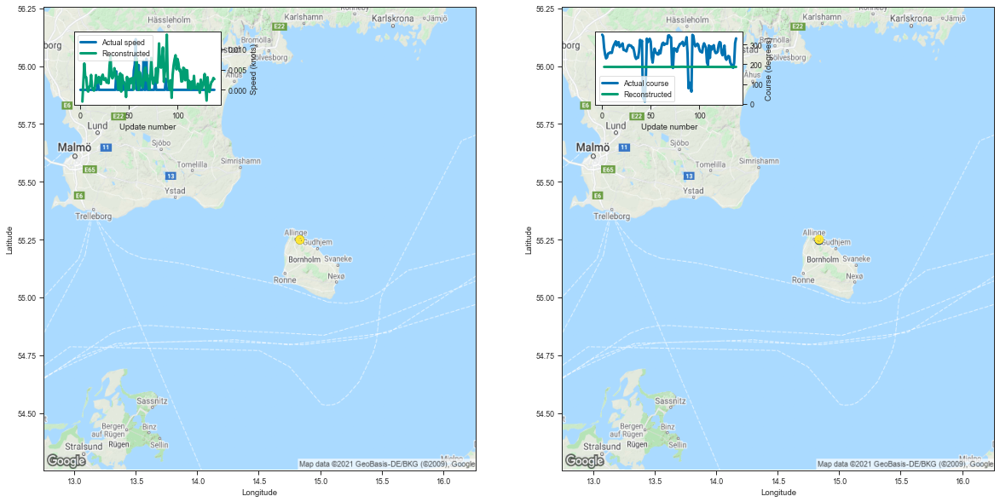

[-0.002892732620239258, 0.0018801689147949219, 0.006500244140625, 0.003123760223388672]


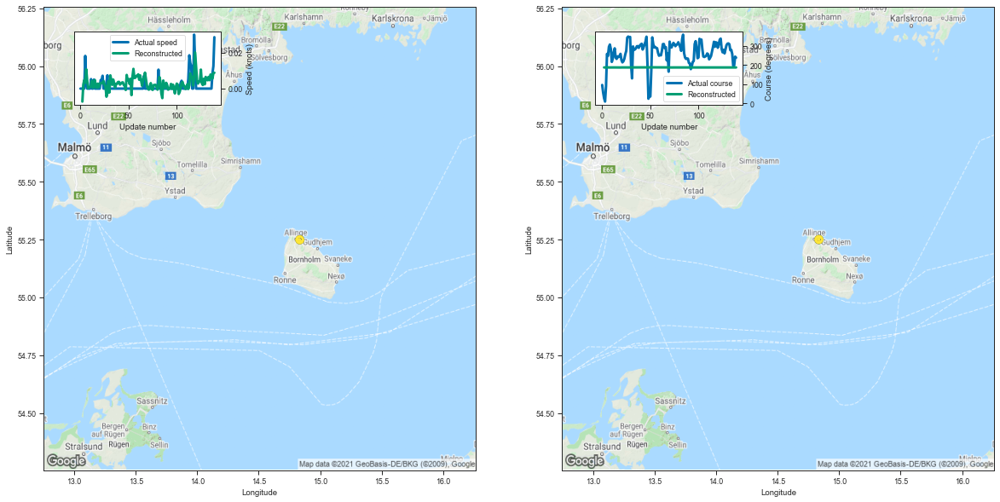

[-0.007210493087768555, 0.002254962921142578, 0.004770755767822266, 0.003285646438598633]


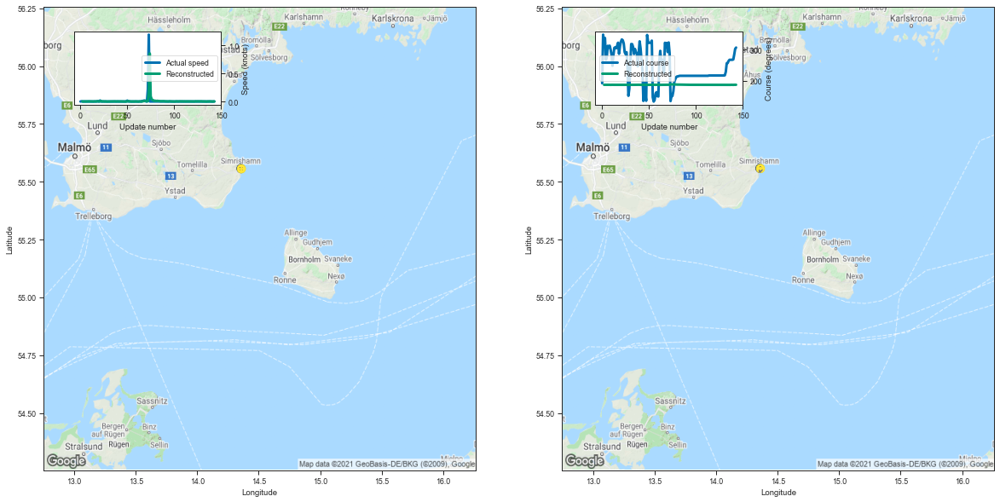

[0.0022668838500976562, -9.5367431640625e-05, 0.0008530616760253906, -2.288818359375e-05]


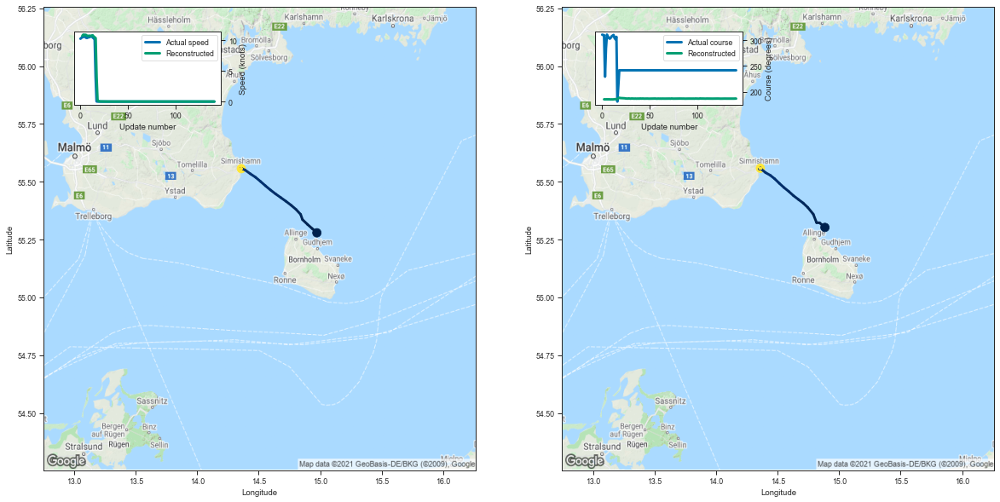

[10.739070892333984, 10.927915573120117, 10.847002029418945, 10.913333892822266]


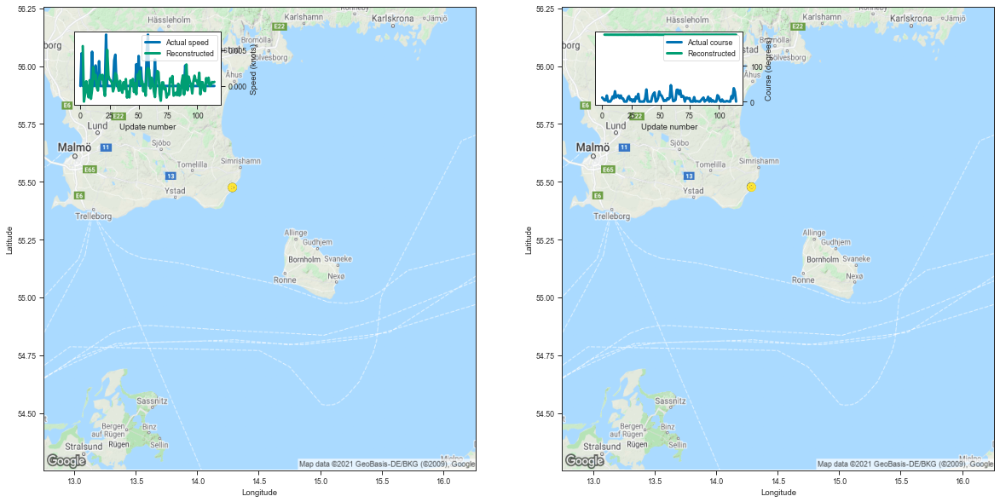

[0.0055446624755859375, -0.0021715164184570312, -0.0010762214660644531, 0.0006475448608398438]


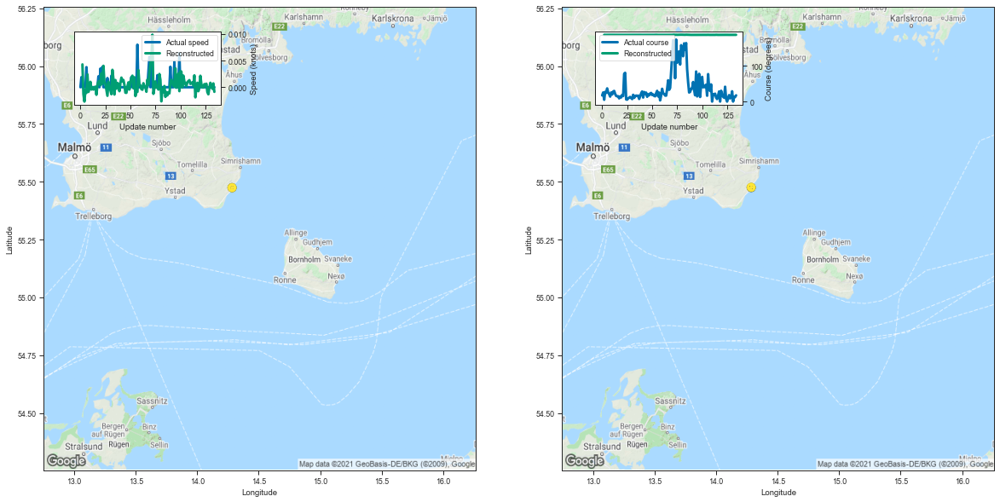

[0.004288196563720703, -0.001325845718383789, -0.002697467803955078, -0.0004742145538330078]


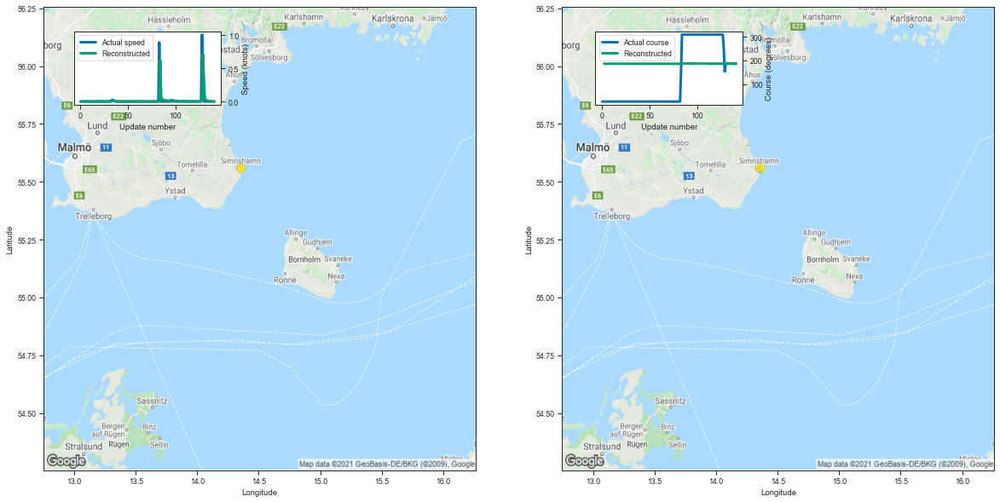

[0.0013689994812011719, 0.002611398696899414, 0.0025119781494140625, 0.0032224655151367188]


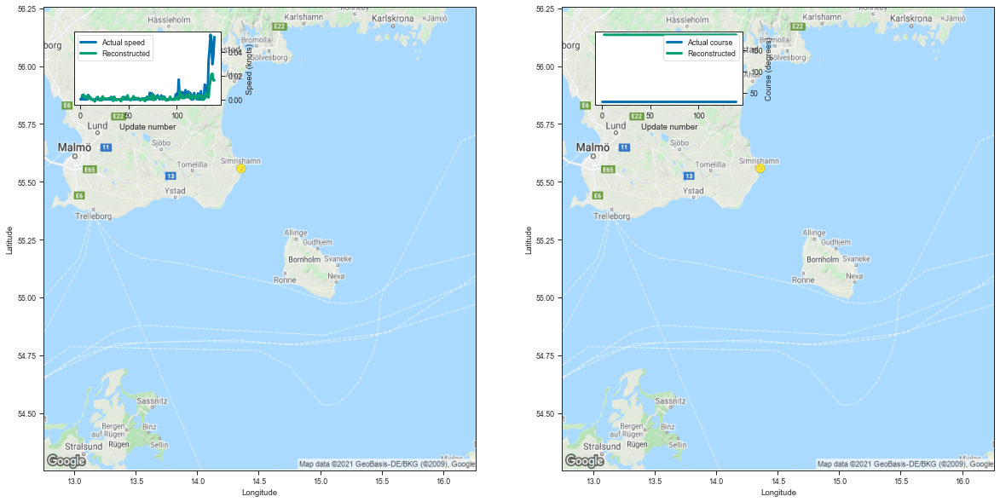

[0.0023419857025146484, 0.00410008430480957, 0.002264261245727539, 0.0027701854705810547]


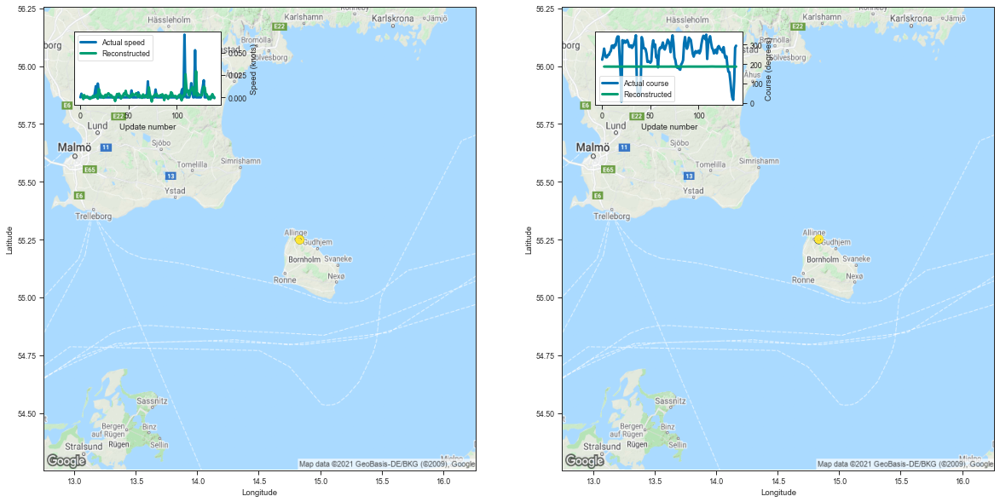

[0.0024275779724121094, -0.0019073486328125, 0.0024747848510742188, -0.00019311904907226562]


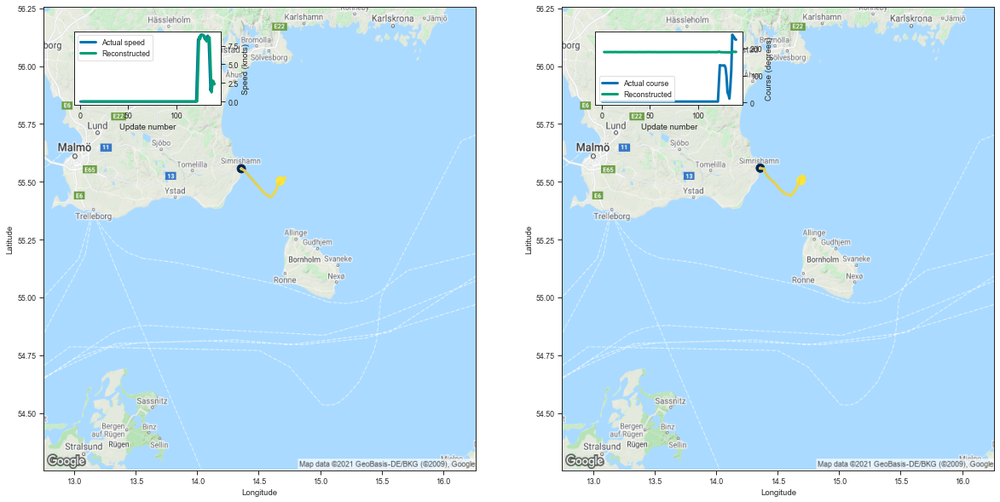

[-0.001607656478881836, 0.003829479217529297, 0.0030541419982910156, 0.002826690673828125]


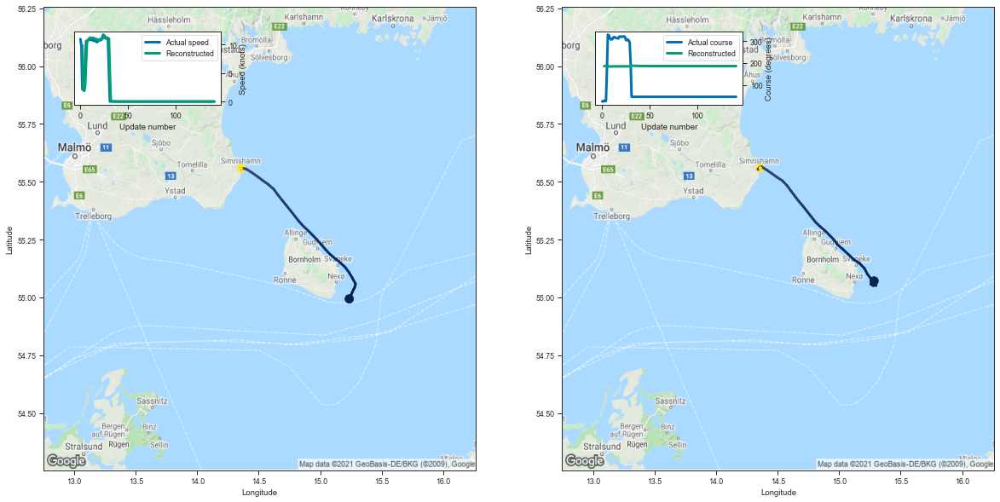

[9.876047134399414, 2.044835090637207, 1.8476576805114746, 2.8028523921966553]


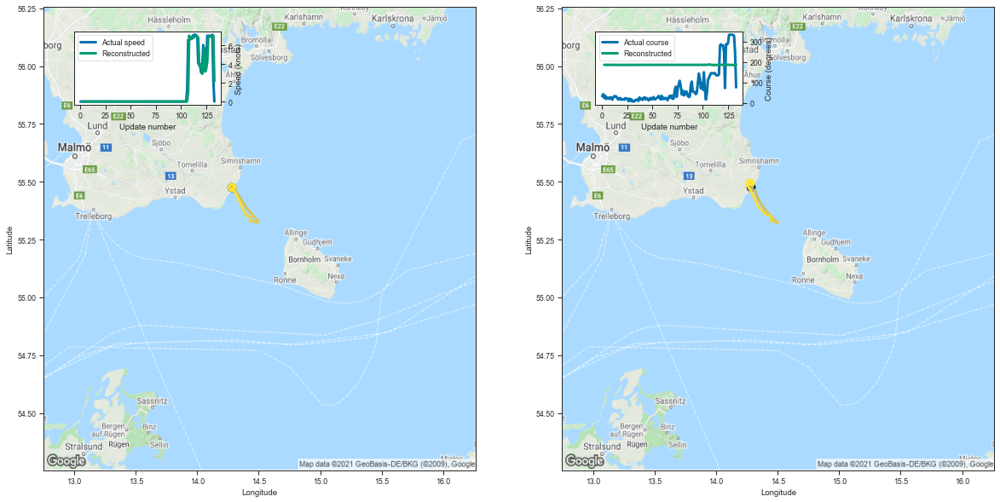

[0.004354953765869141, -0.0013322830200195312, -0.000209808349609375, -0.0012705326080322266]


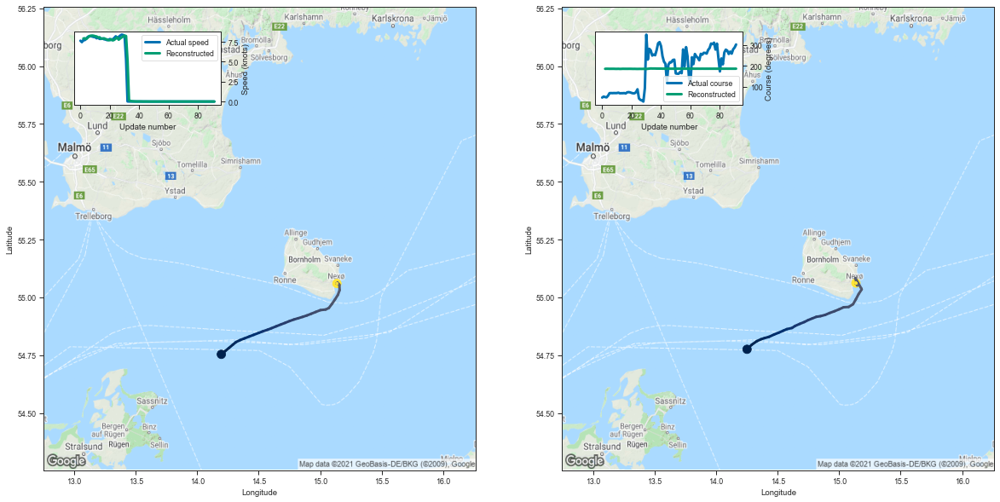

[7.9268035888671875, 7.952611446380615, 7.862524032592773, 8.038337707519531]


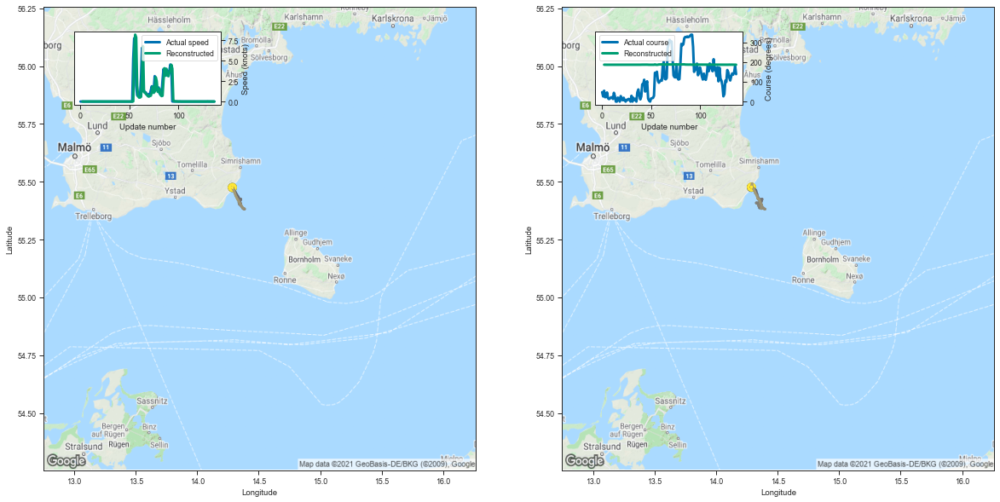

[0.004633426666259766, -0.0021686553955078125, -0.0023636817932128906, -4.57763671875e-05]


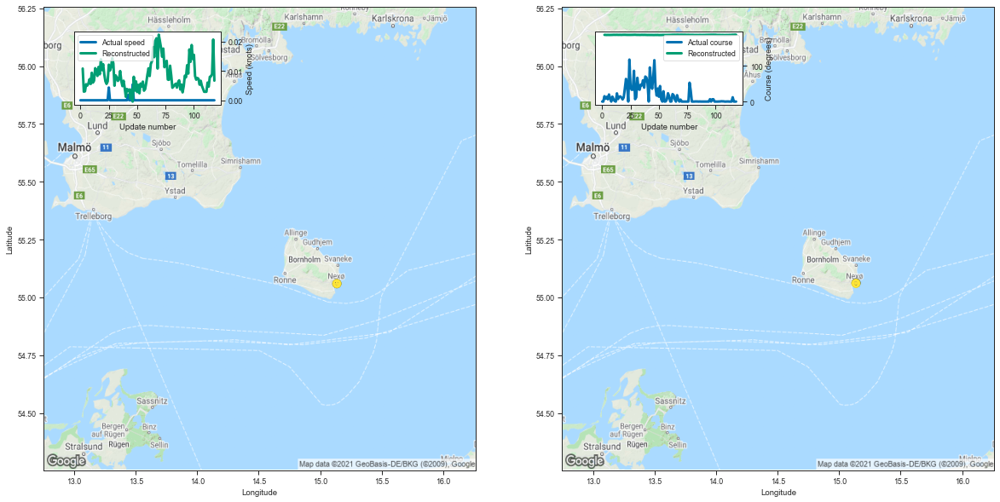

[0.010829925537109375, 0.0029463768005371094, 0.003056764602661133, 0.005481243133544922]


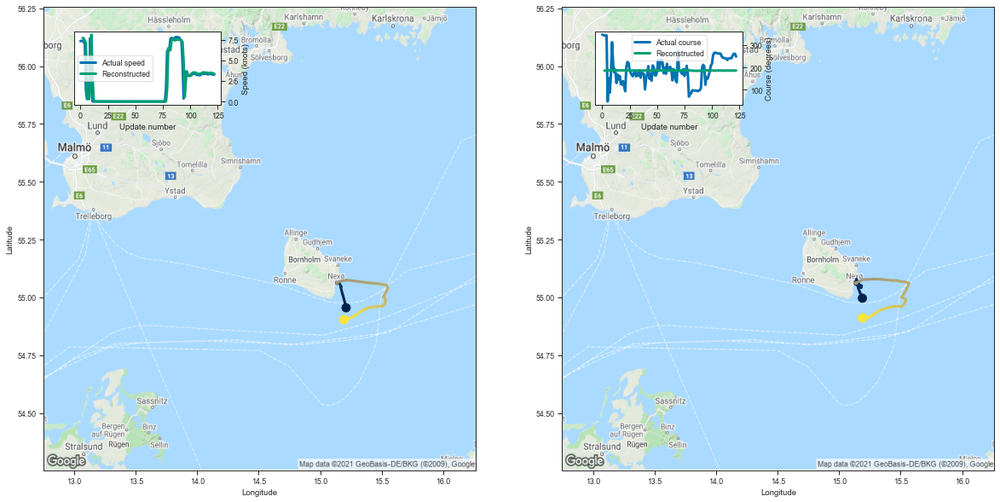

[7.715051174163818, 7.646697521209717, 7.3984270095825195, 7.030394554138184]


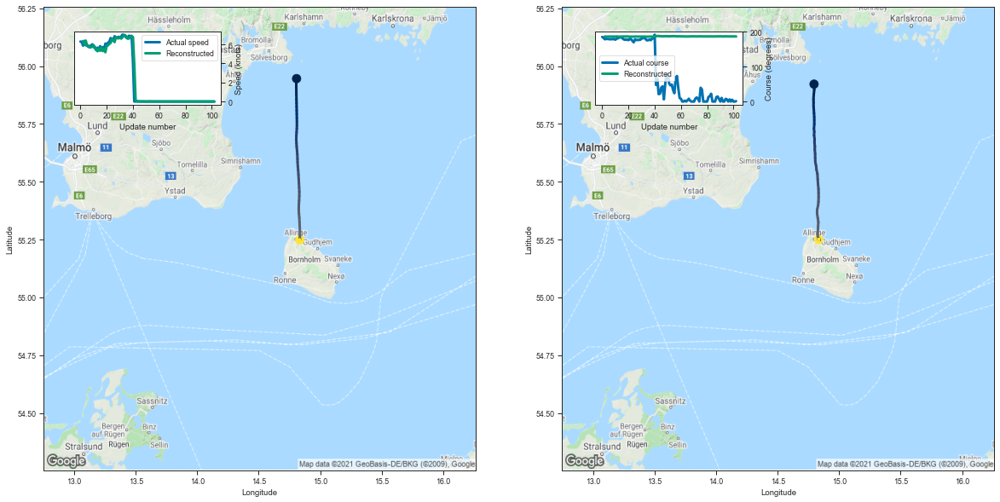

[6.36125373840332, 6.001165390014648, 6.406942367553711, 5.9207844734191895]


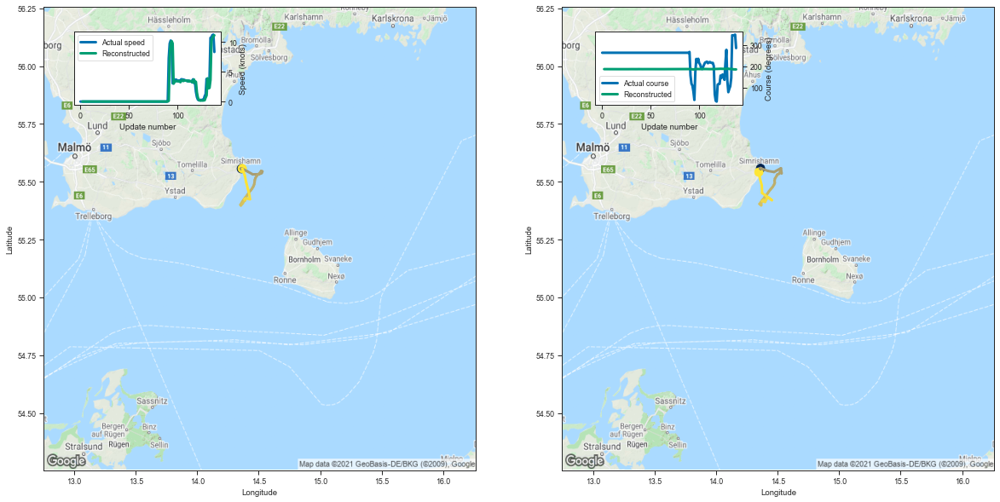

[0.00046753883361816406, 9.72747802734375e-05, 0.0003170967102050781, 0.0008196830749511719]


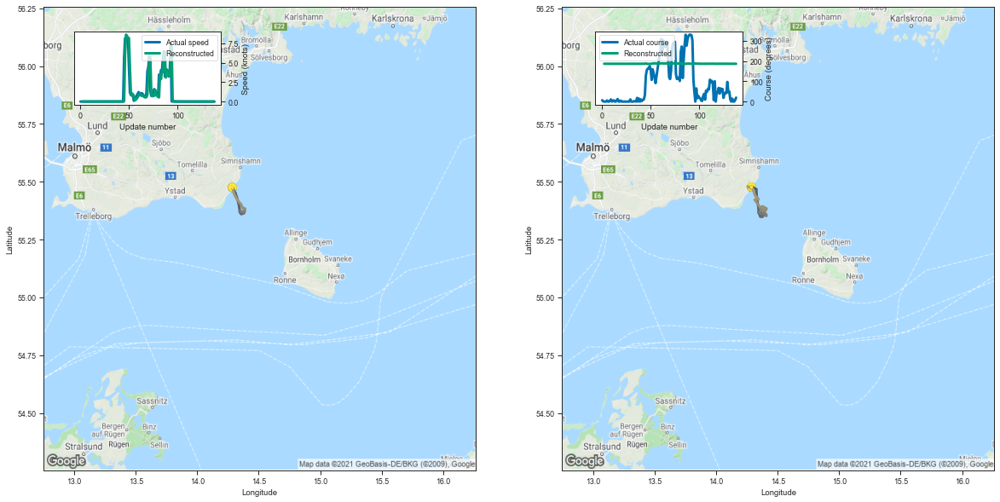

[0.0032062530517578125, -0.002803802490234375, -0.0005042552947998047, -5.6743621826171875e-05]


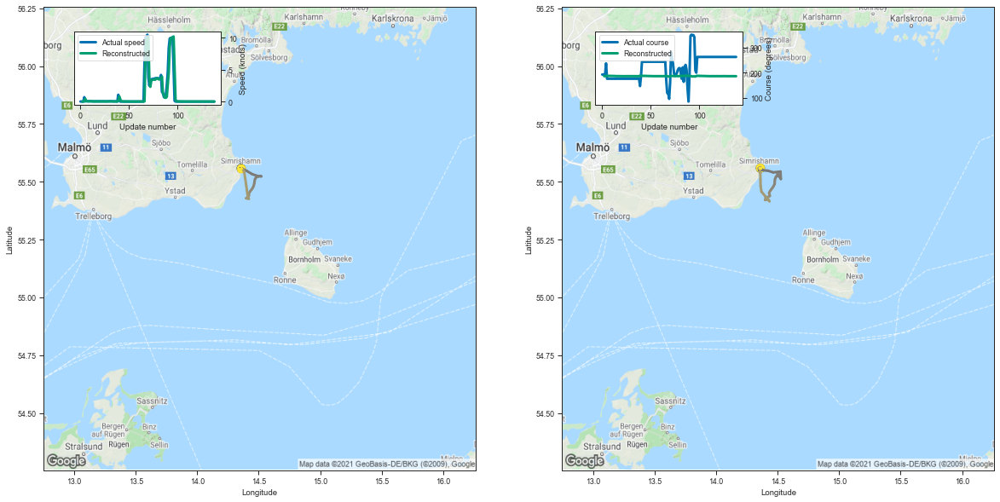

[0.0028357505798339844, 0.00037479400634765625, 0.017308473587036133, 0.44155311584472656]


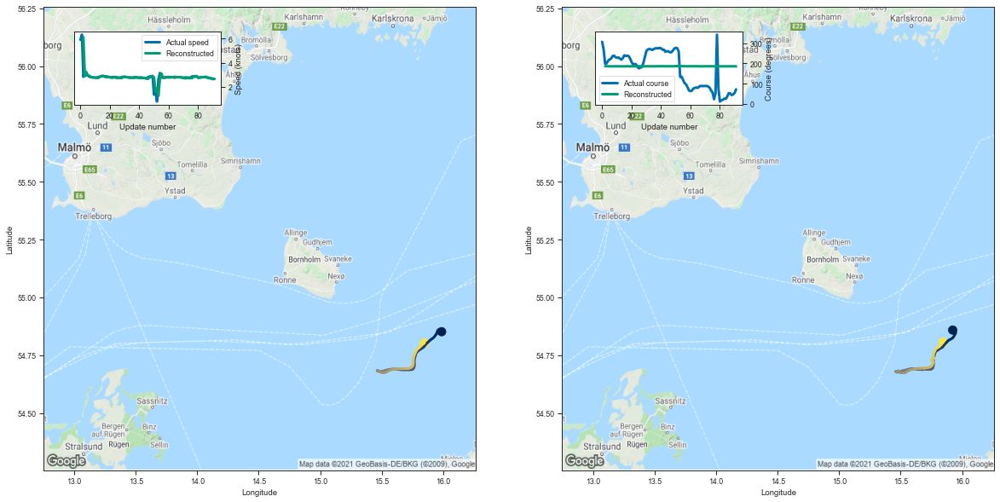

[6.117619037628174, 2.8963749408721924, 3.2266366481781006, 2.947026252746582]


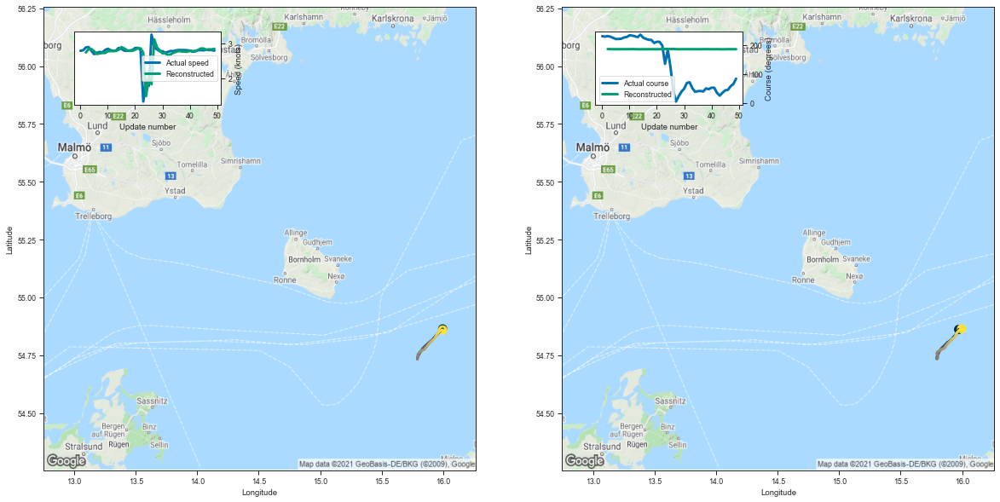

[2.7378716468811035, 2.8372726440429688, 2.8346338272094727, 2.7738420963287354]


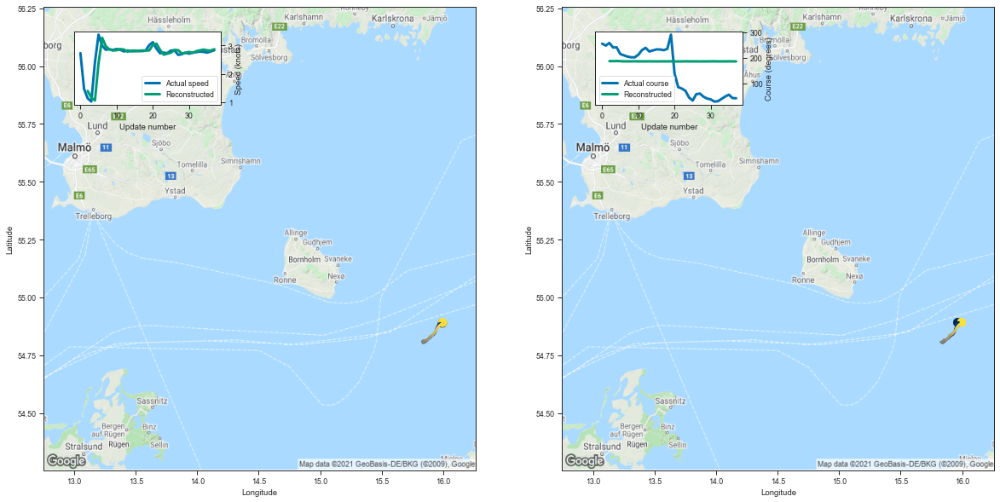

[1.3972245454788208, 1.161902666091919, 1.059882640838623, 2.3696141242980957]


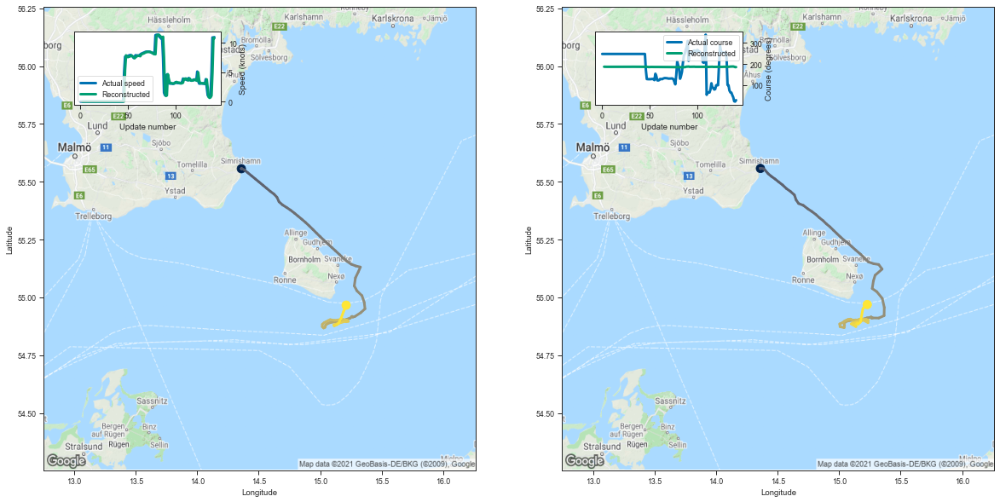

[-0.0009822845458984375, -4.291534423828125e-06, -0.0019698143005371094, 0.002321004867553711]


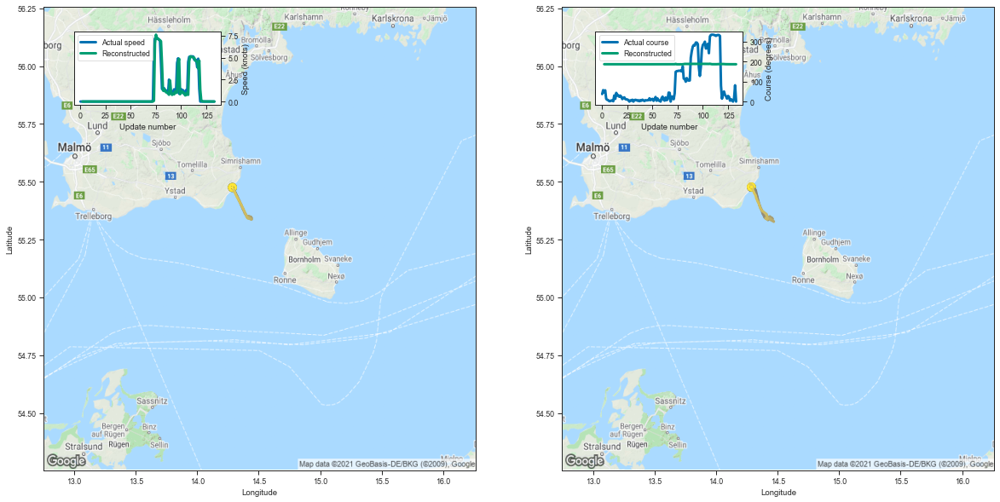

[0.0015473365783691406, -0.003215312957763672, -0.0018448829650878906, -0.00040435791015625]


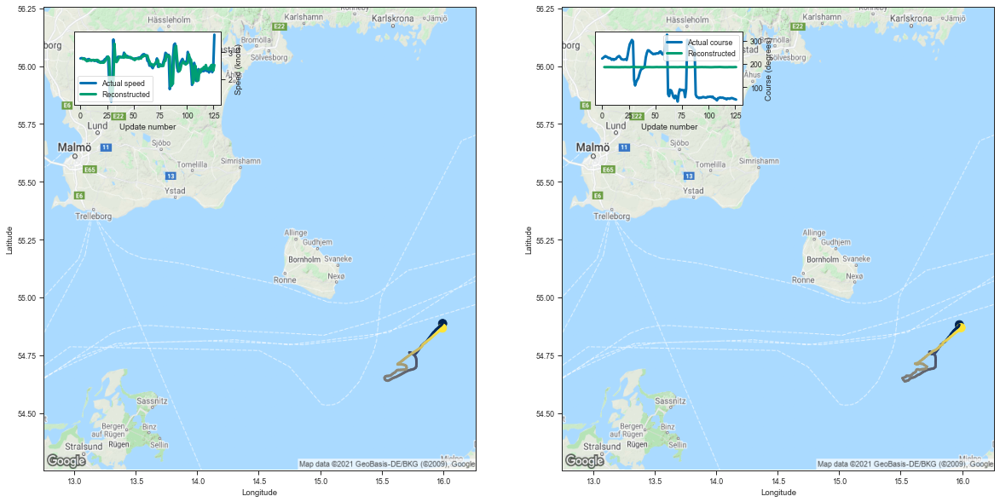

[2.745236396789551, 2.7695908546447754, 2.729728937149048, 2.719632625579834]


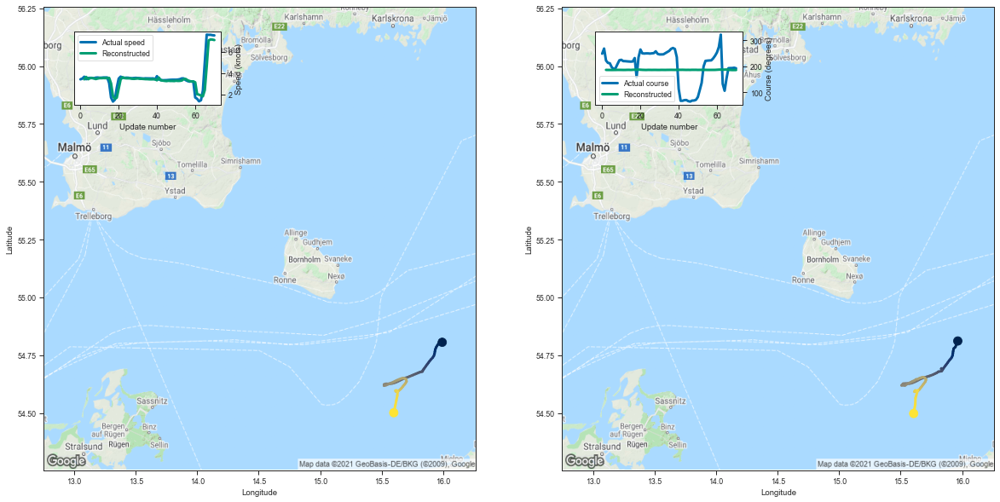

[3.4264354705810547, 3.648359537124634, 3.4357681274414062, 3.5326385498046875]


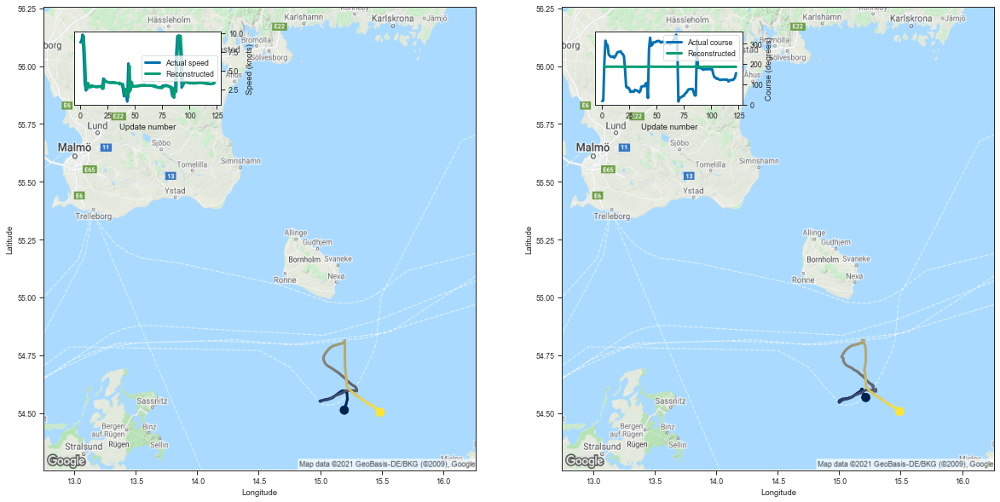

[8.597214698791504, 9.603816986083984, 6.993037700653076, 3.5195984840393066]


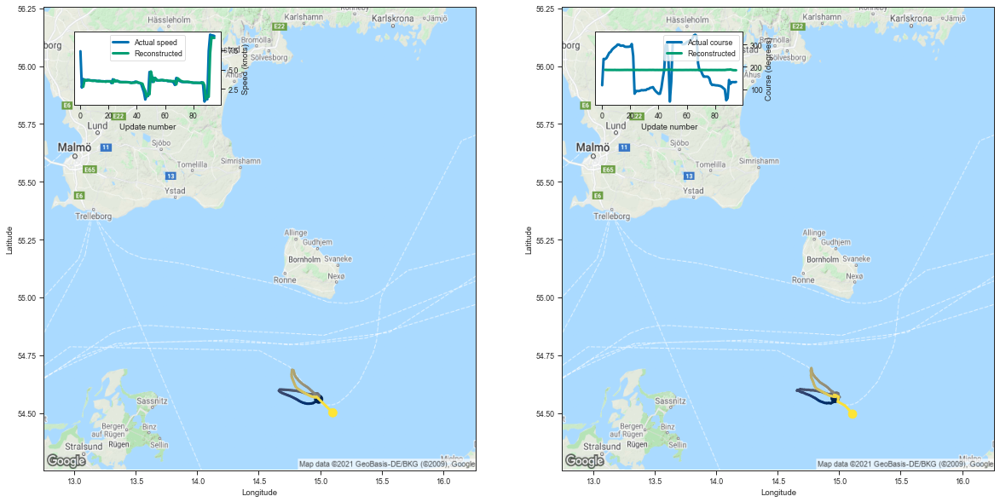

[2.789644956588745, 3.7039318084716797, 3.5792880058288574, 3.597215175628662]


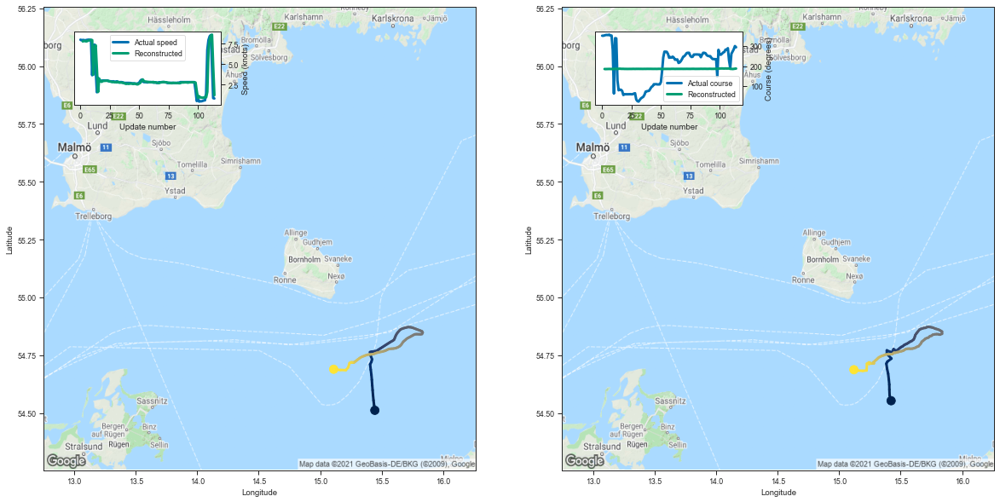

[7.785405158996582, 7.8597917556762695, 7.822025299072266, 7.792314529418945]


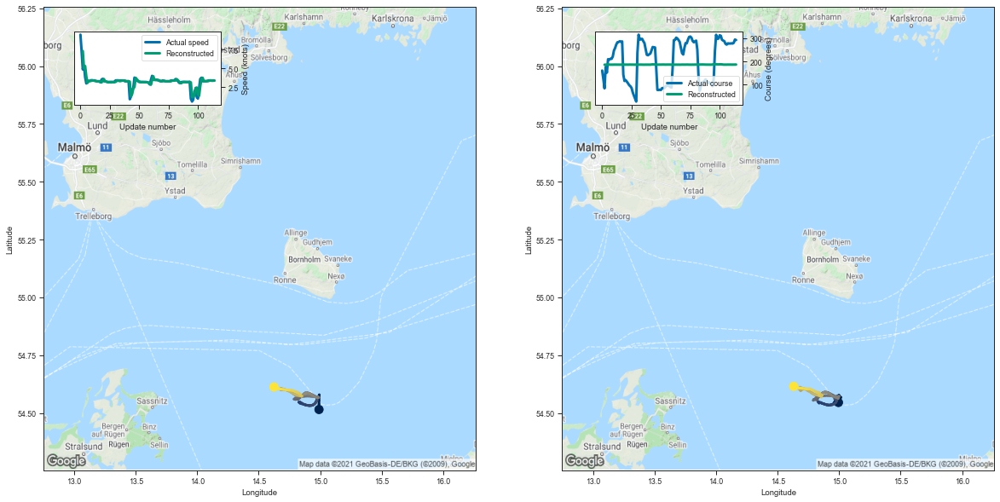

[7.331775188446045, 5.0580549240112305, 5.319960594177246, 3.950467109680176]


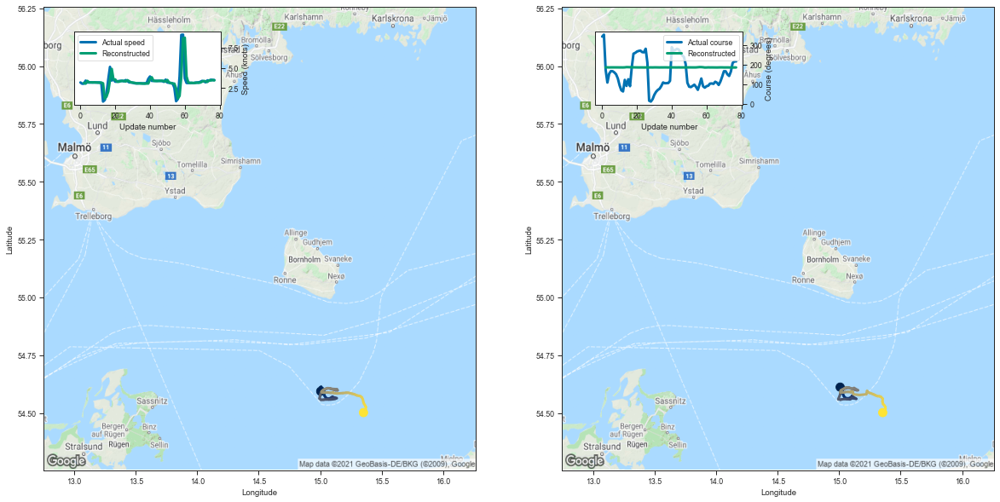

[3.145409107208252, 3.0538299083709717, 3.391531467437744, 3.208000659942627]


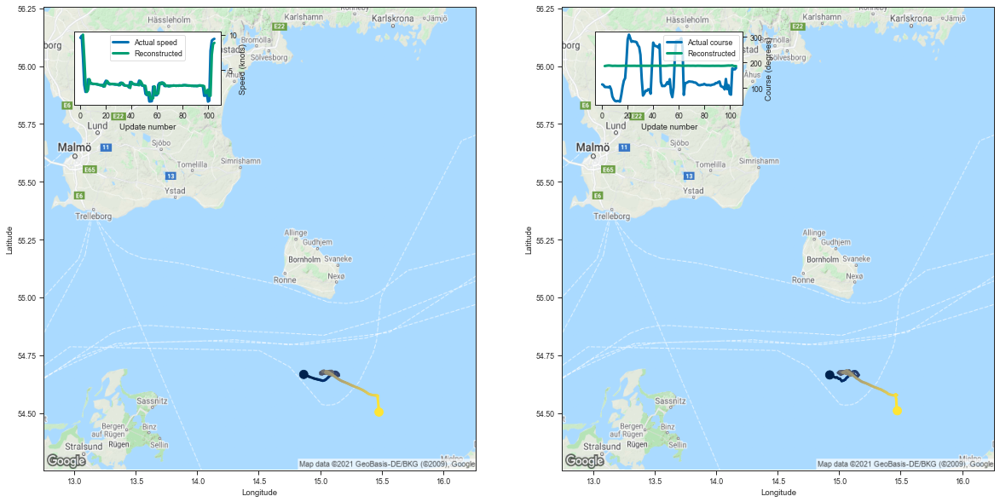

[9.98995590209961, 6.803553104400635, 3.074131965637207, 1.9251999855041504]


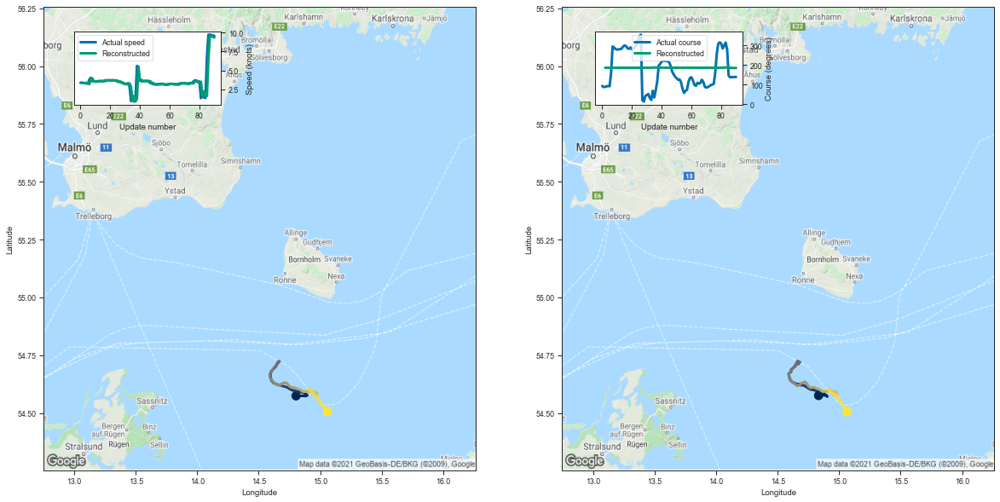

[3.3630456924438477, 3.2947497367858887, 3.2704014778137207, 3.3172430992126465]


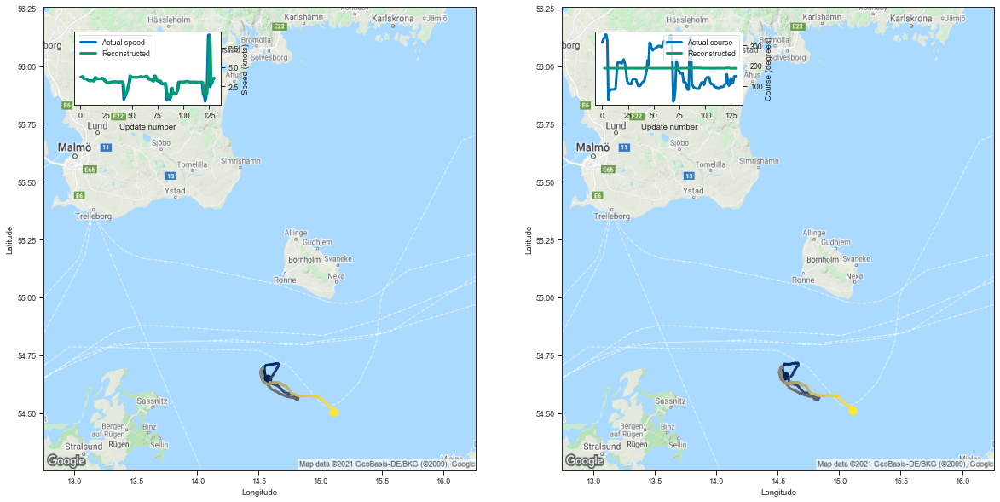

[3.8245699405670166, 3.7543978691101074, 3.5159823894500732, 3.498732089996338]


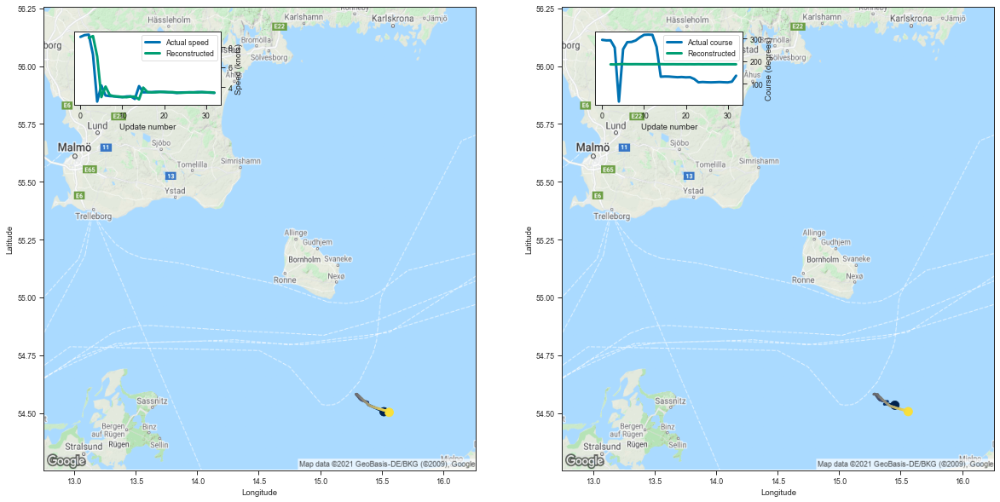

[8.923683166503906, 9.096908569335938, 7.066529750823975, 3.008246421813965]


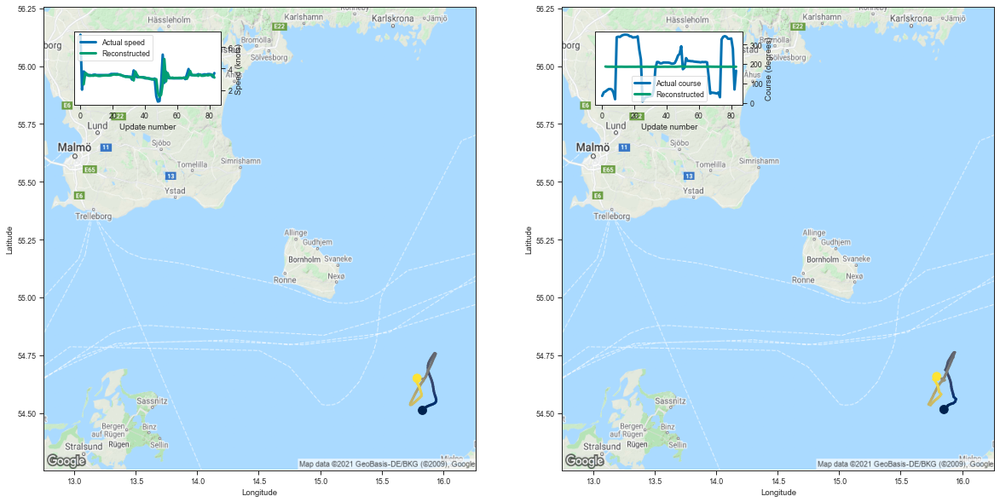

[2.53654408454895, 3.599666118621826, 3.4920406341552734, 3.3374505043029785]


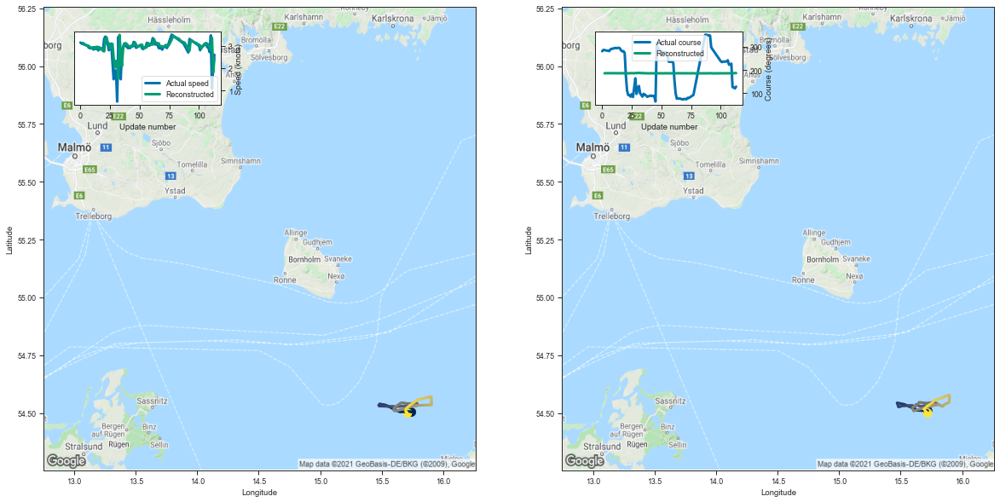

[3.1309876441955566, 3.089090585708618, 3.0592803955078125, 3.0249252319335938]


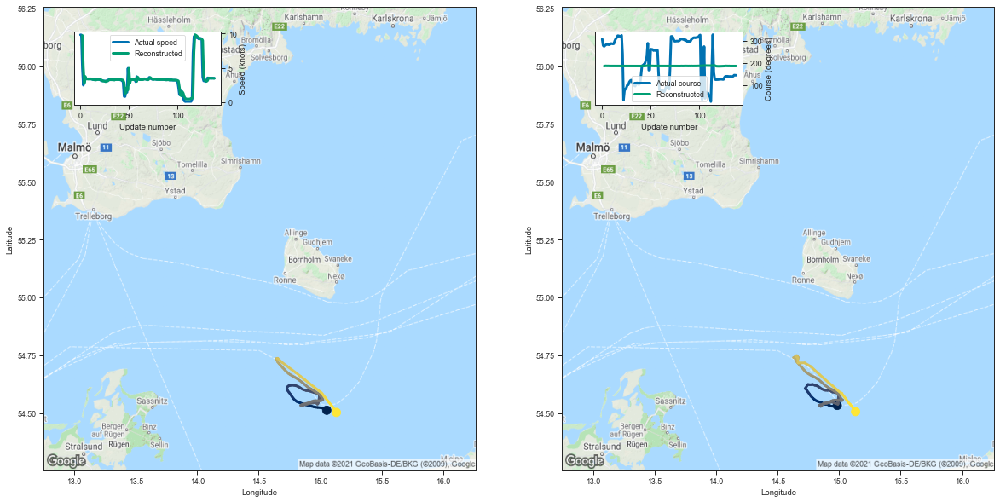

[9.726282119750977, 5.118527412414551, 2.757737159729004, 3.7367305755615234]


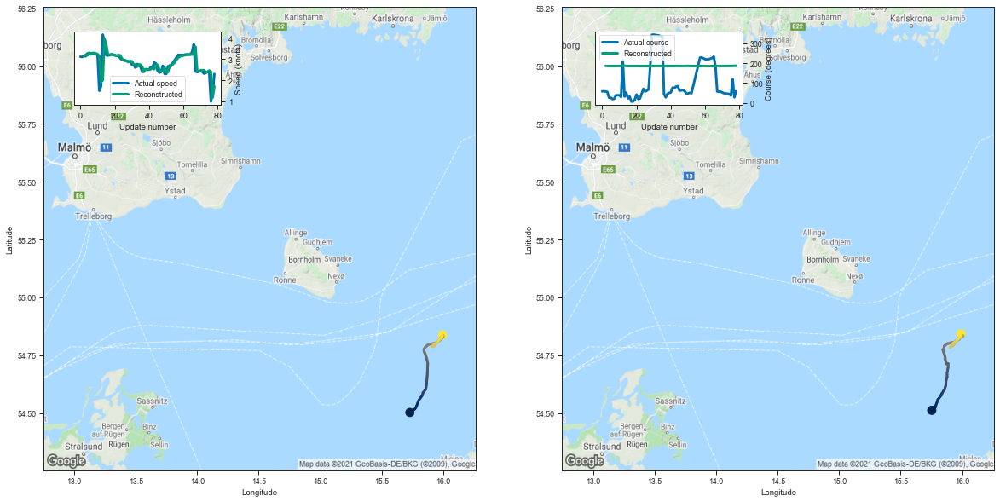

[3.1372647285461426, 3.203787326812744, 3.169516086578369, 3.2957606315612793]


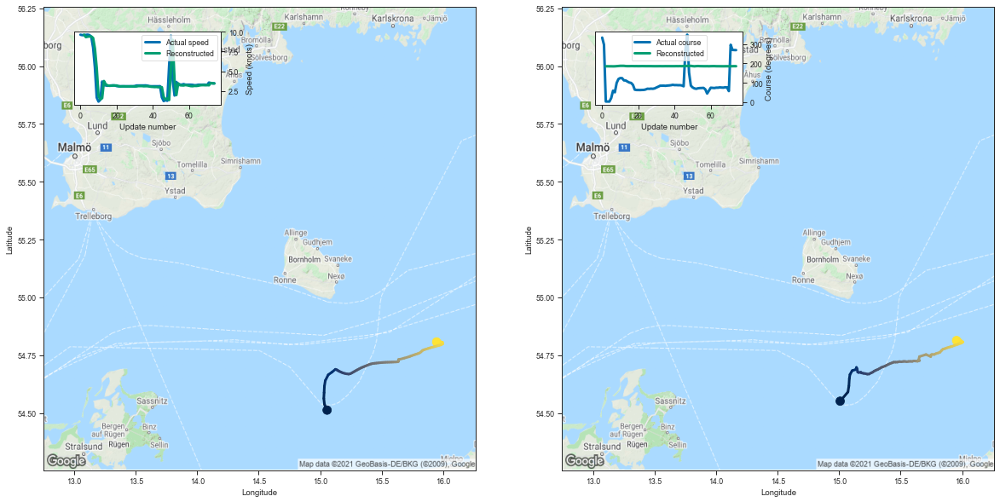

[9.644105911254883, 9.325416564941406, 9.38447093963623, 9.410951614379883]


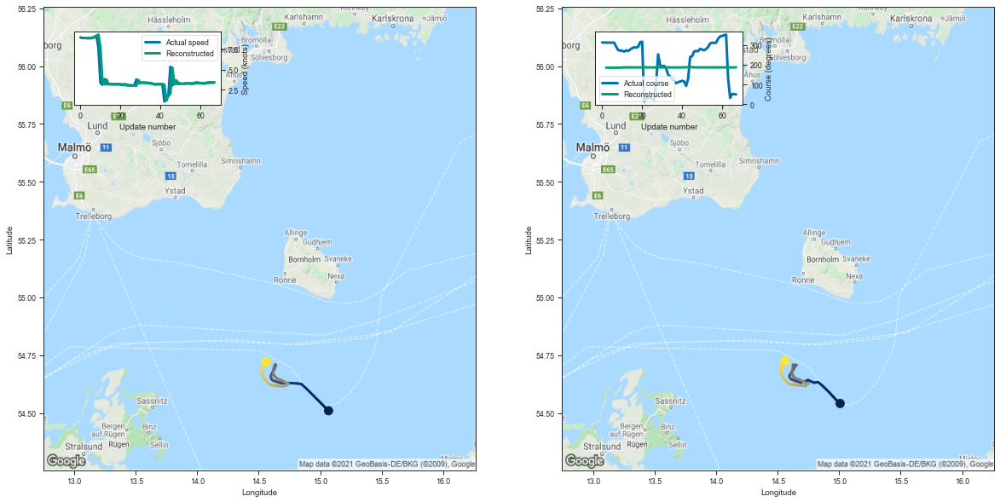

[8.899787902832031, 8.878118515014648, 8.901595115661621, 8.89911937713623]


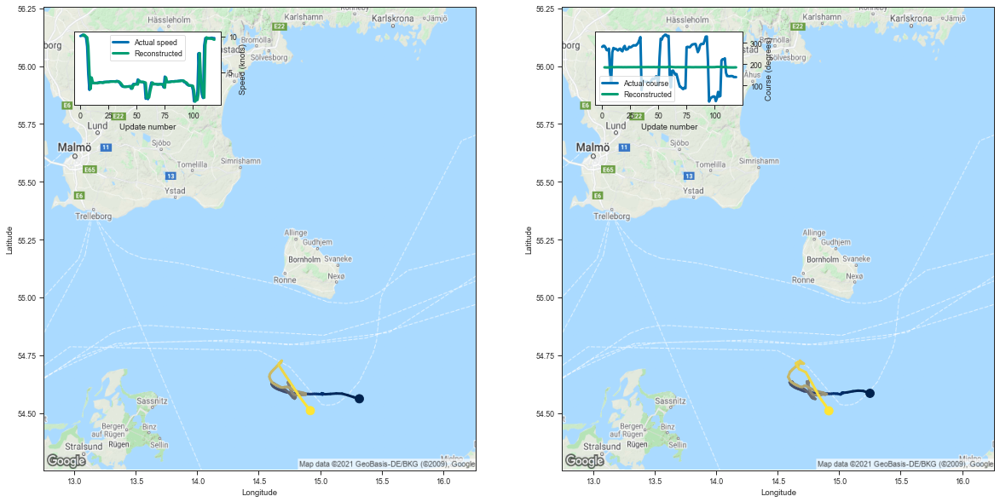

[10.110210418701172, 10.269392013549805, 10.171525955200195, 10.019859313964844]


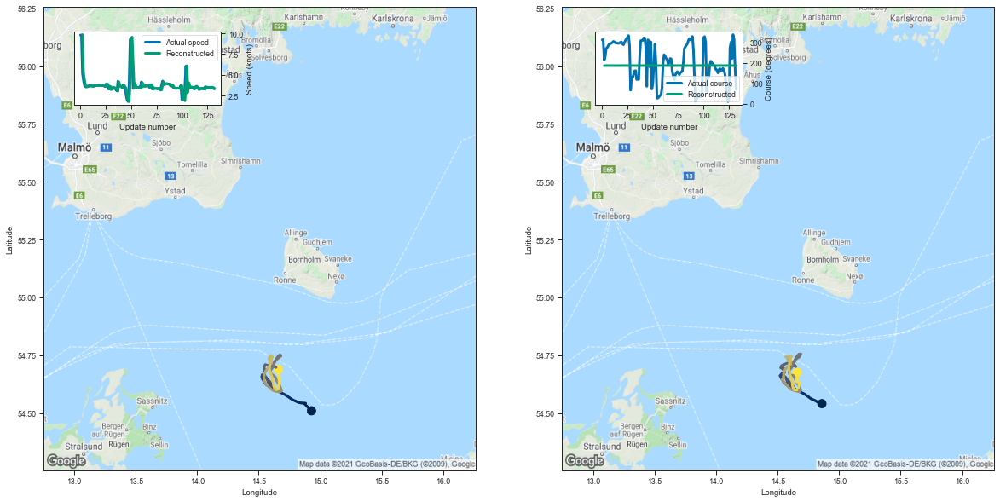

[9.846536636352539, 5.355251312255859, 4.394256591796875, 3.7612485885620117]


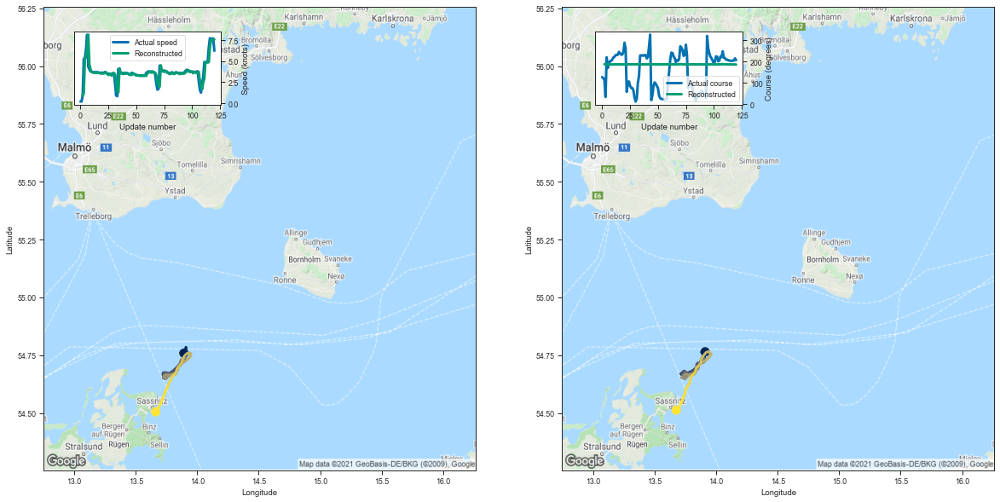

[0.8996776342391968, 1.1587440967559814, 5.280808448791504, 5.488218307495117]


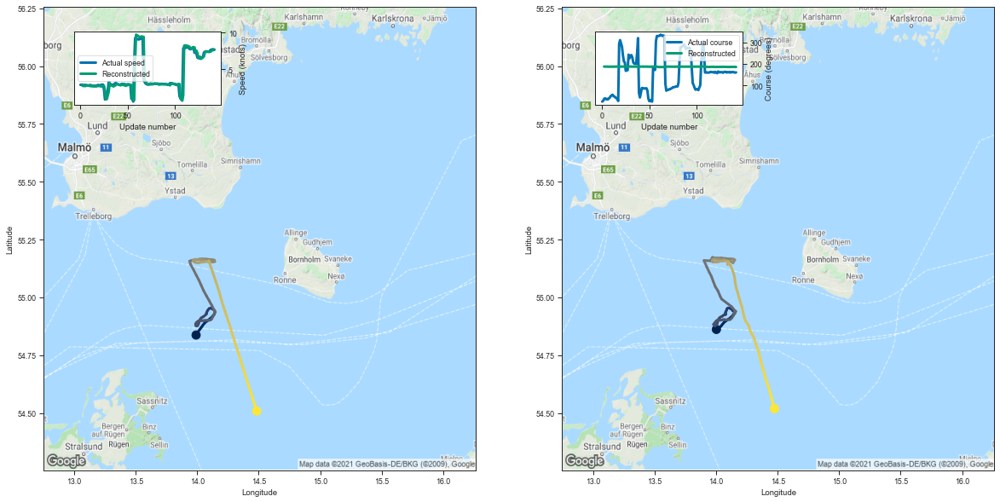

[2.9170913696289062, 2.7056095600128174, 2.7311763763427734, 2.685544490814209]


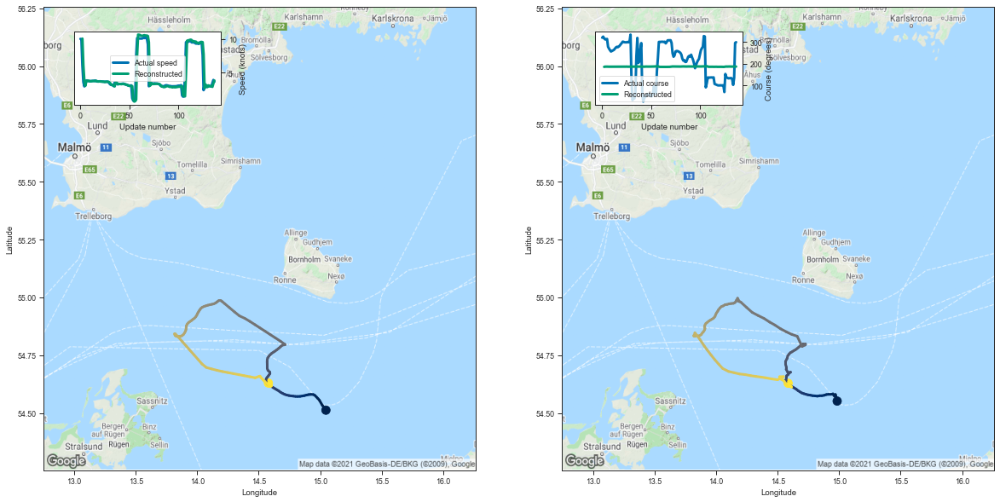

[10.060041427612305, 6.110544681549072, 3.8136396408081055, 3.0763912200927734]


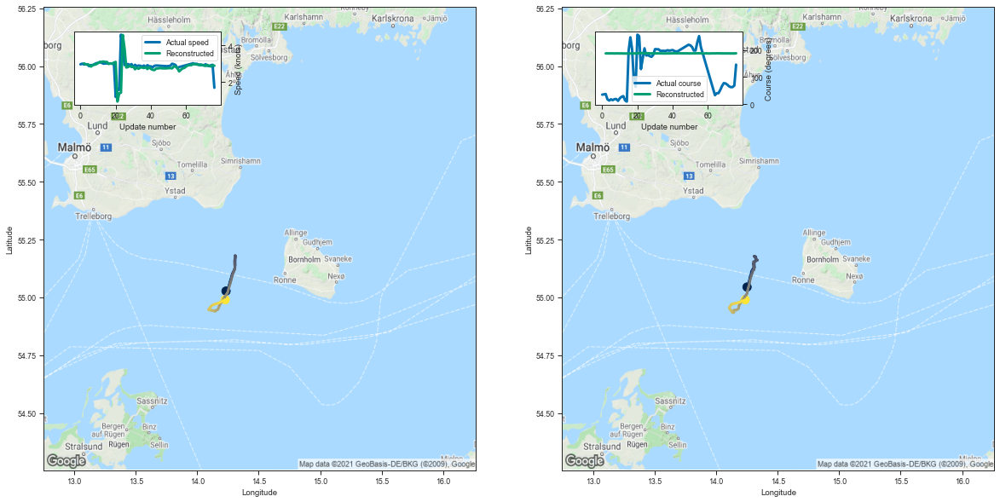

[3.0185225009918213, 2.967562437057495, 2.9697675704956055, 2.9344375133514404]


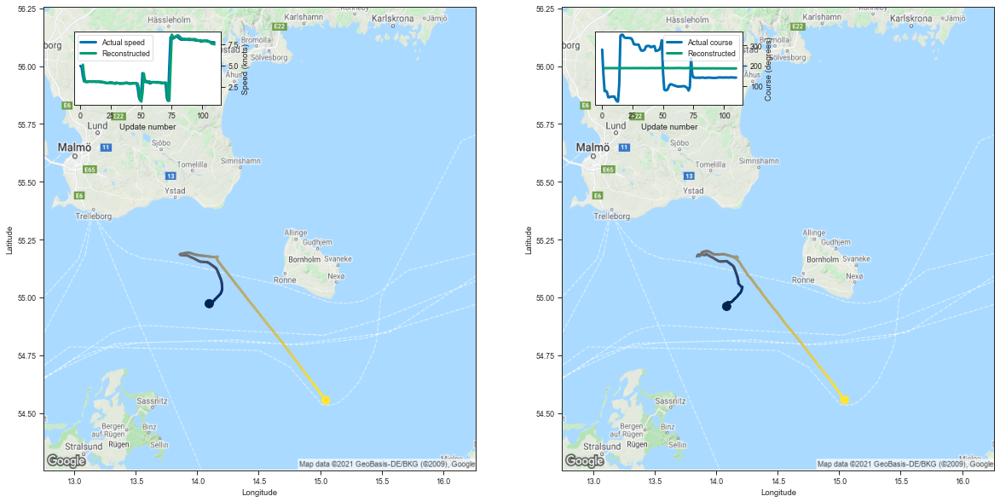

[5.074268817901611, 3.773923873901367, 3.0923681259155273, 3.0319619178771973]


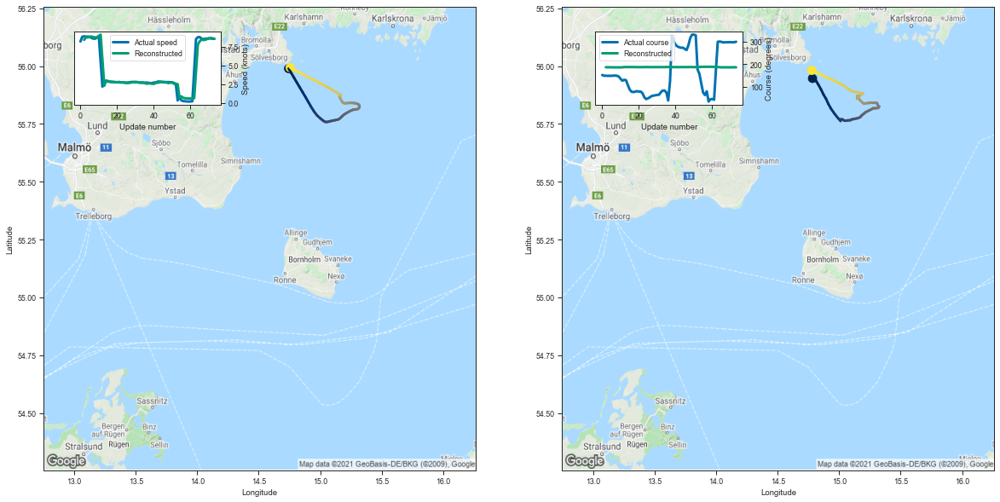

[8.387462615966797, 8.71849250793457, 8.712400436401367, 8.771568298339844]


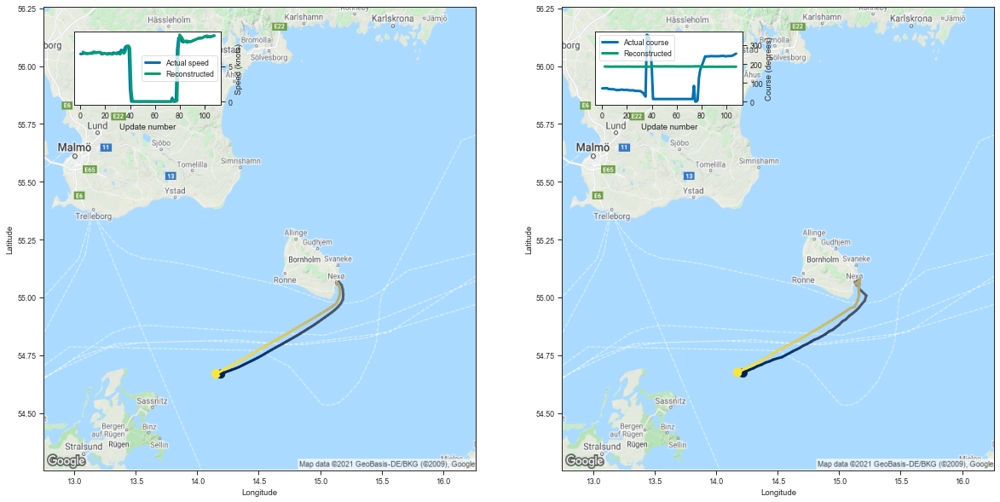

[7.004000186920166, 6.887803554534912, 6.84356164932251, 6.808534622192383]


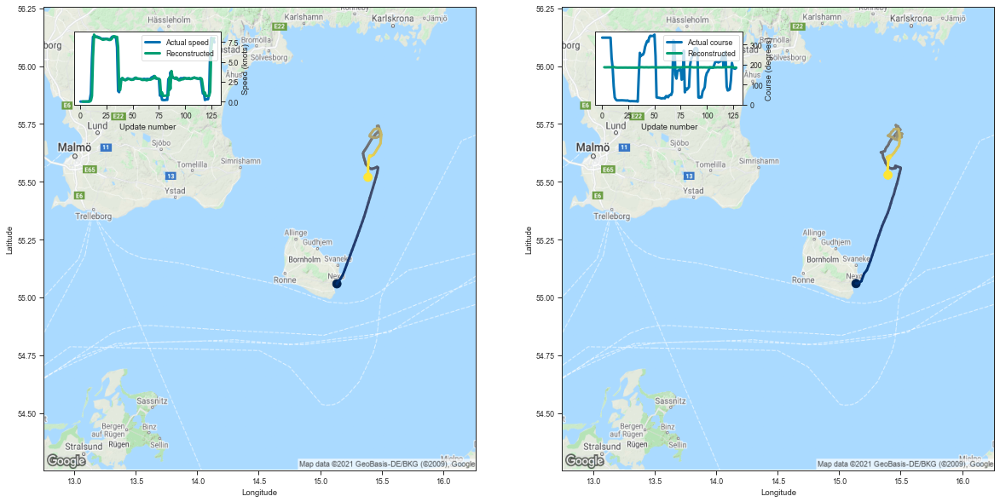

[0.006279468536376953, 0.0025877952575683594, -0.00018739700317382812, 0.004954338073730469]


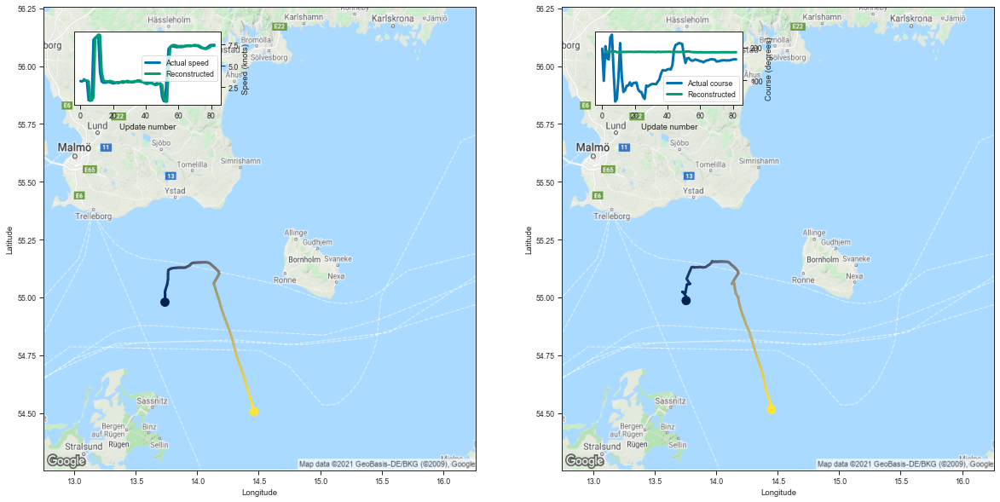

[3.441150188446045, 3.331846237182617, 3.2840020656585693, 3.197481155395508]


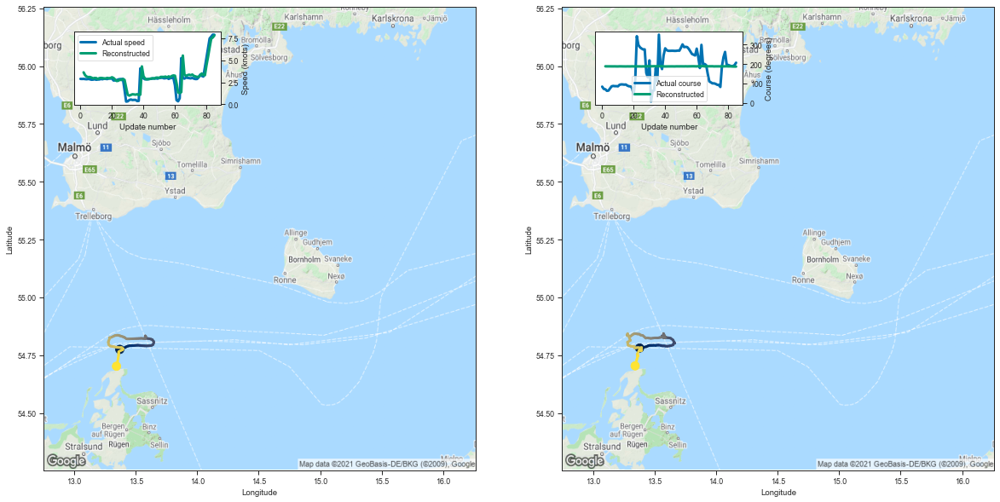

[3.6260437965393066, 3.2911596298217773, 3.1362180709838867, 3.08754301071167]


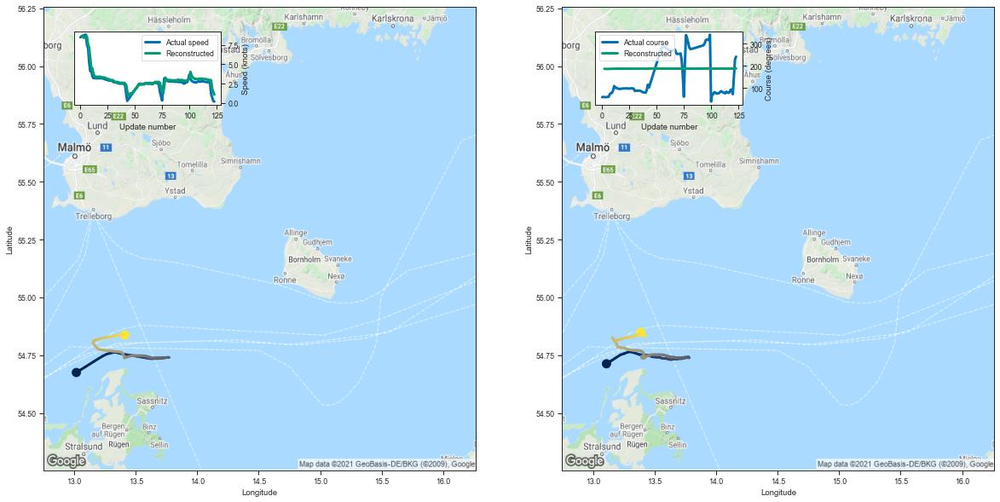

[8.59874153137207, 8.418373107910156, 8.404869079589844, 8.508466720581055]


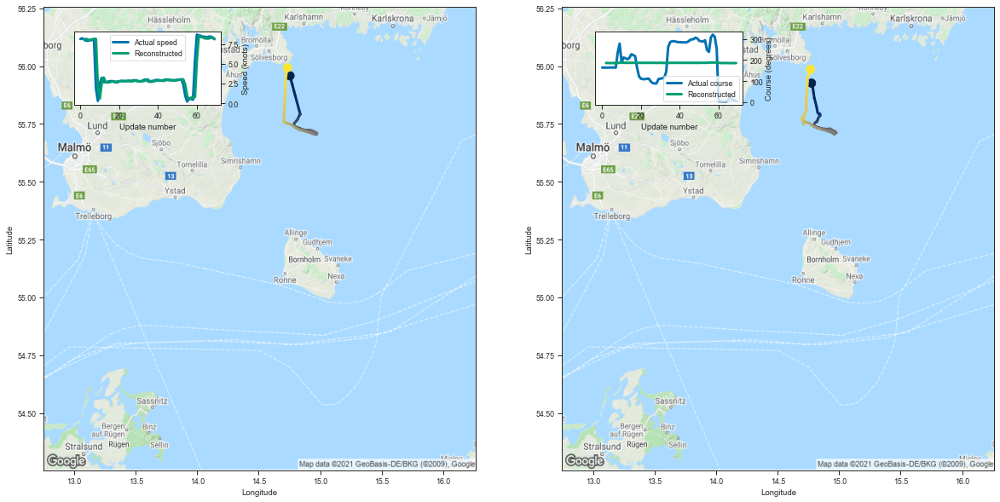

[7.983378887176514, 8.13880729675293, 7.990970134735107, 8.014328956604004]


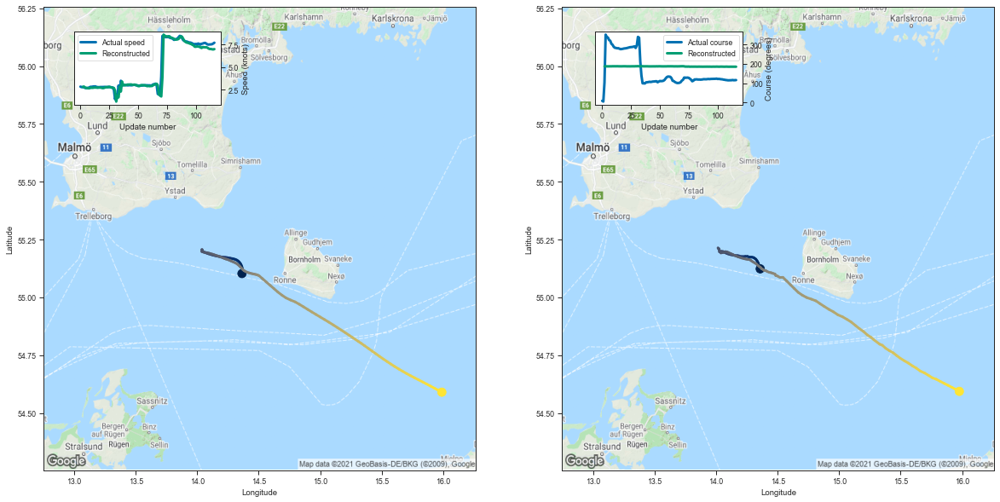

[2.817436933517456, 2.860100746154785, 2.7553064823150635, 2.6940865516662598]


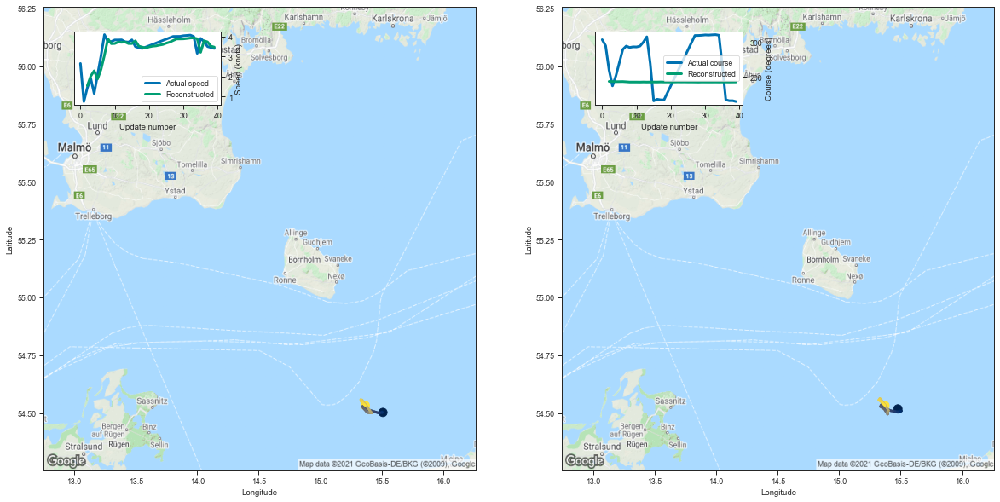

[1.5416414737701416, 2.0154688358306885, 2.2863070964813232, 1.877551555633545]


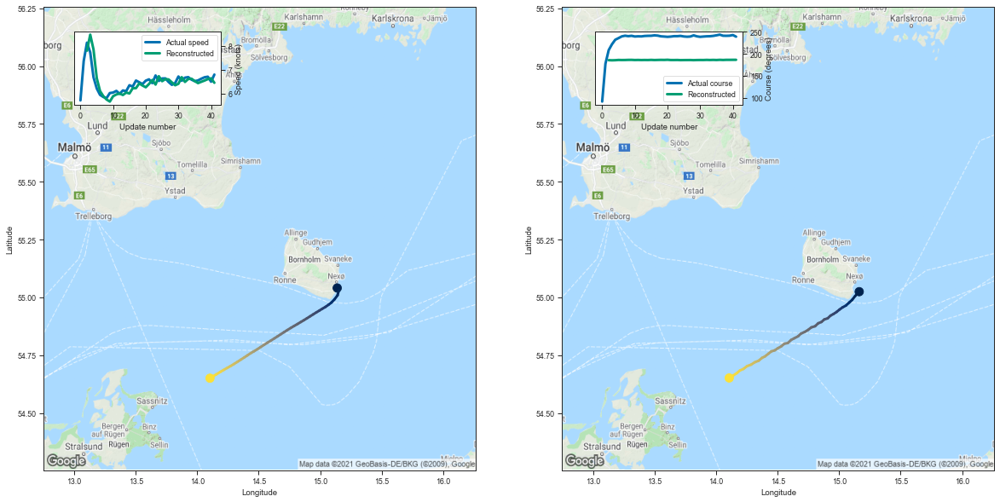

[7.799800872802734, 8.474737167358398, 7.851595878601074, 6.646842002868652]


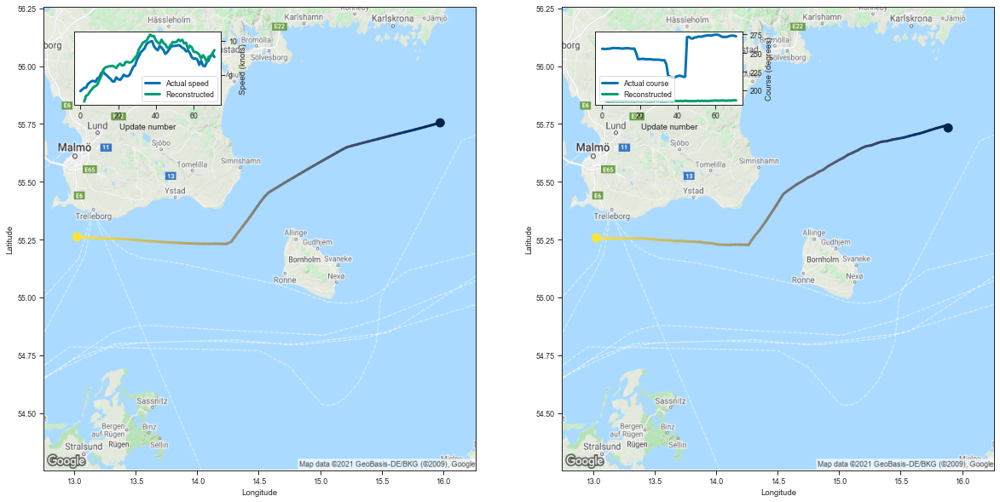

[8.224534034729004, 8.392942428588867, 8.42582893371582, 8.515218734741211]


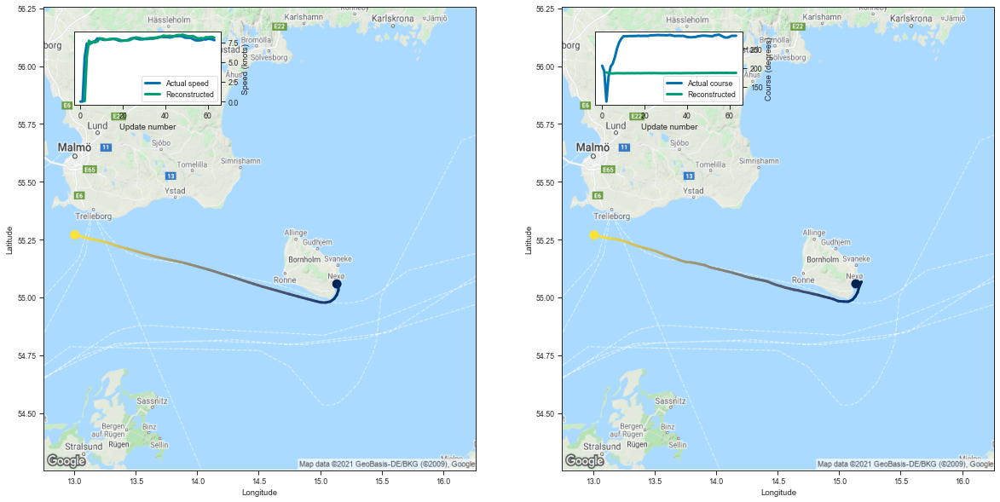

[0.03961896896362305, 5.686750411987305, 7.708868026733398, 7.352751731872559]


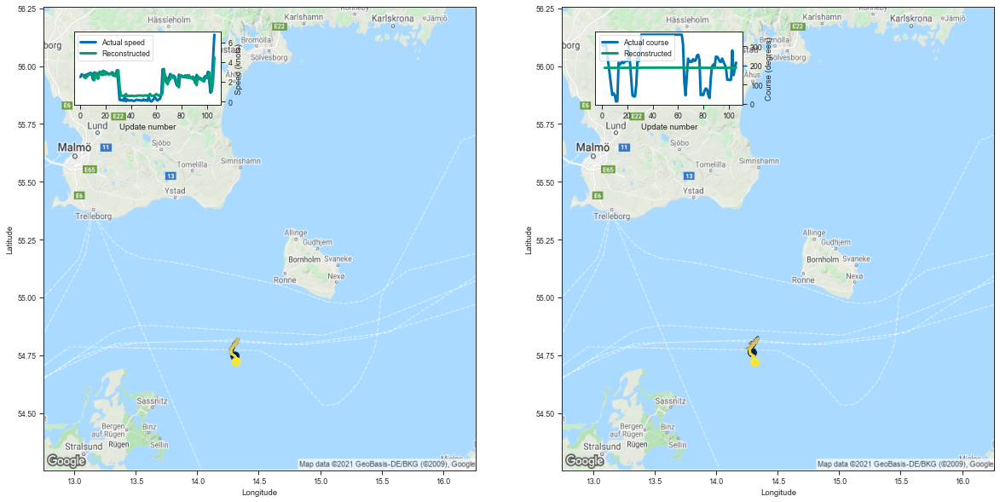

[2.642712116241455, 2.4613587856292725, 2.3817591667175293, 2.492192268371582]


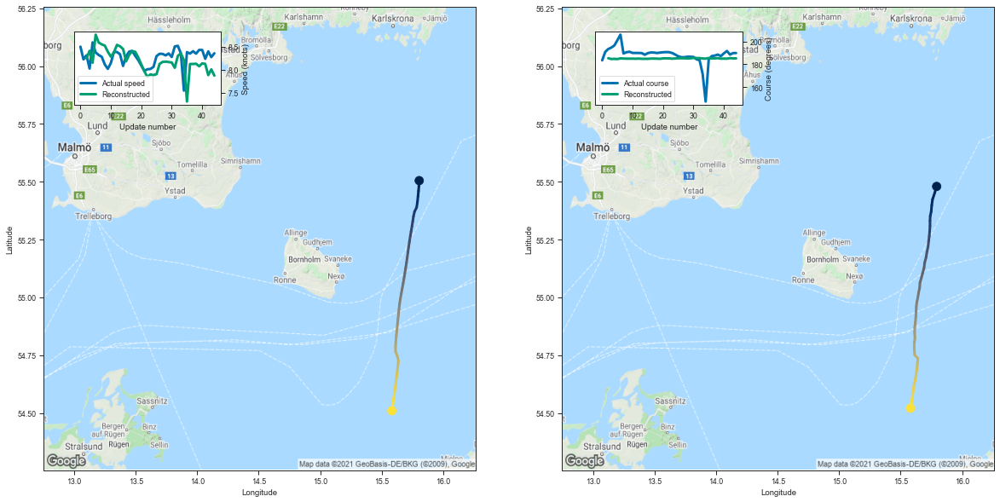

[8.247008323669434, 8.409849166870117, 8.152153015136719, 8.760147094726562]


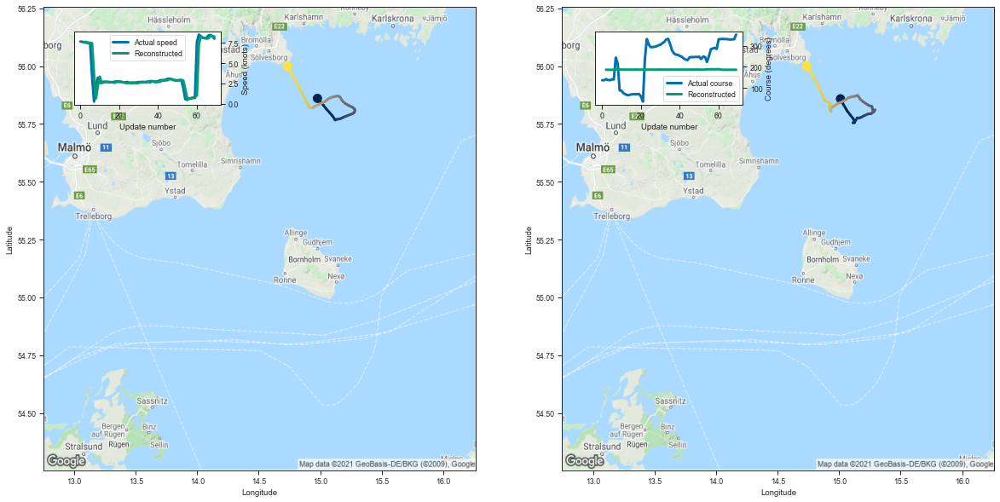

[7.596580505371094, 7.599279403686523, 7.525753974914551, 7.488080978393555]


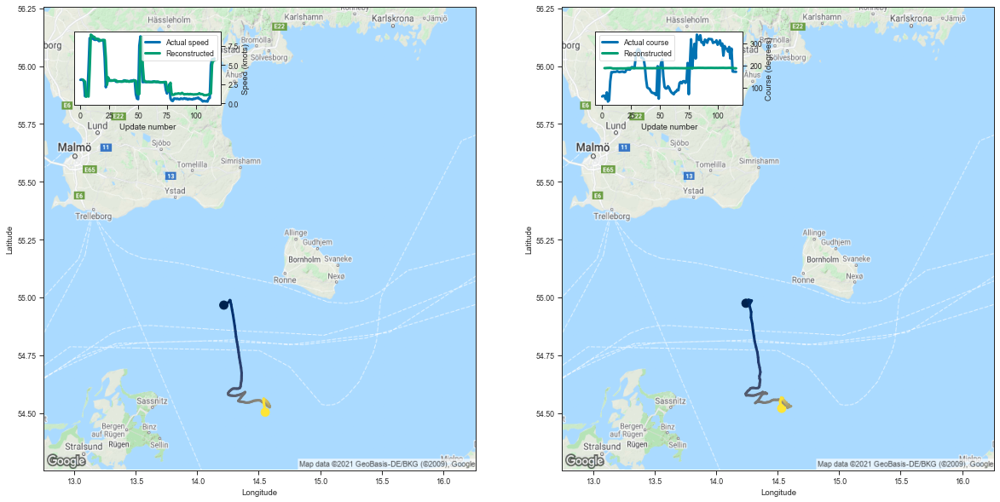

[3.0936827659606934, 2.949500560760498, 2.816230535507202, 0.8455603122711182]


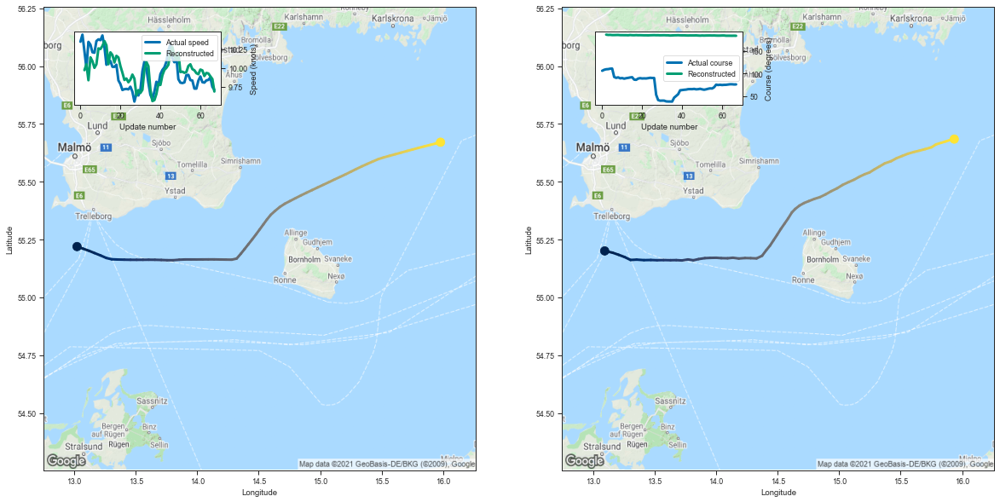

[9.97111701965332, 10.048460006713867, 9.837303161621094, 10.140466690063477]


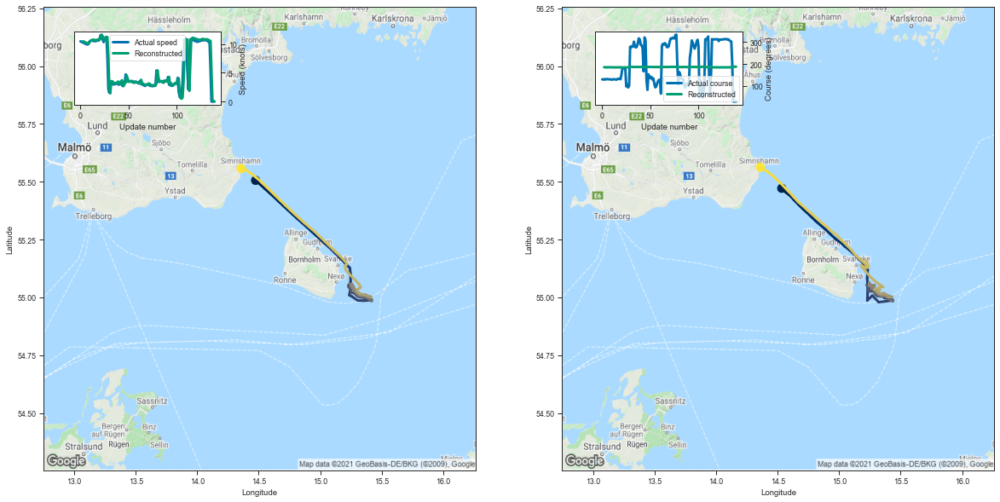

[10.401058197021484, 10.489286422729492, 10.36968994140625, 10.318496704101562]


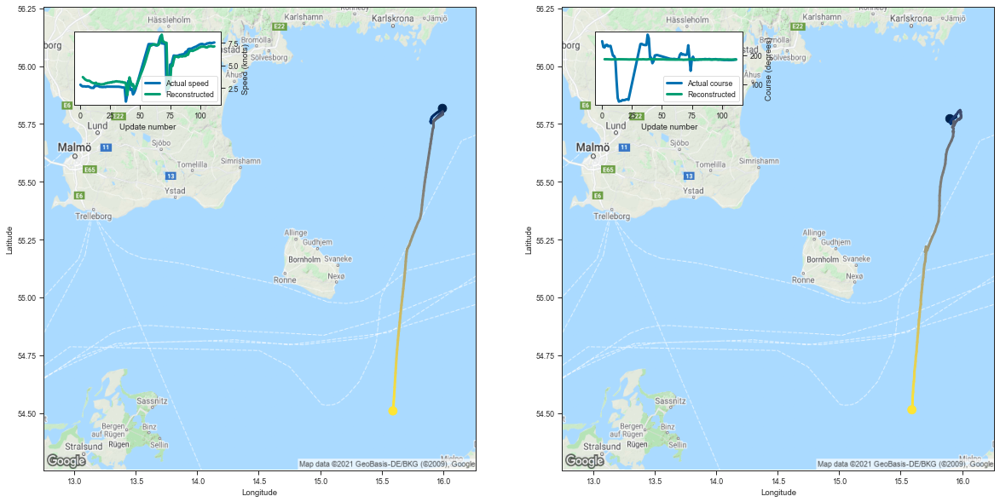

[3.7167086601257324, 3.585899829864502, 3.449638605117798, 3.3768792152404785]


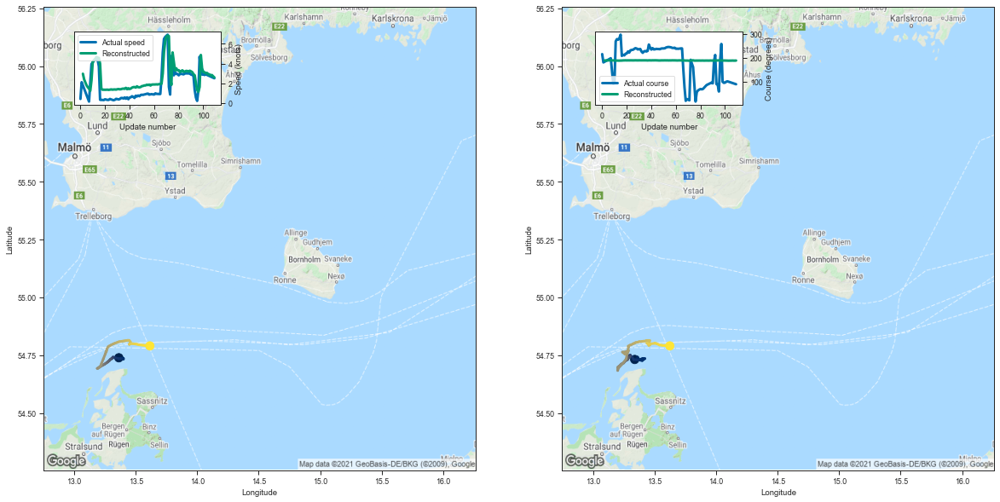

[2.959627151489258, 2.3935048580169678, 2.0791730880737305, 1.7824668884277344]


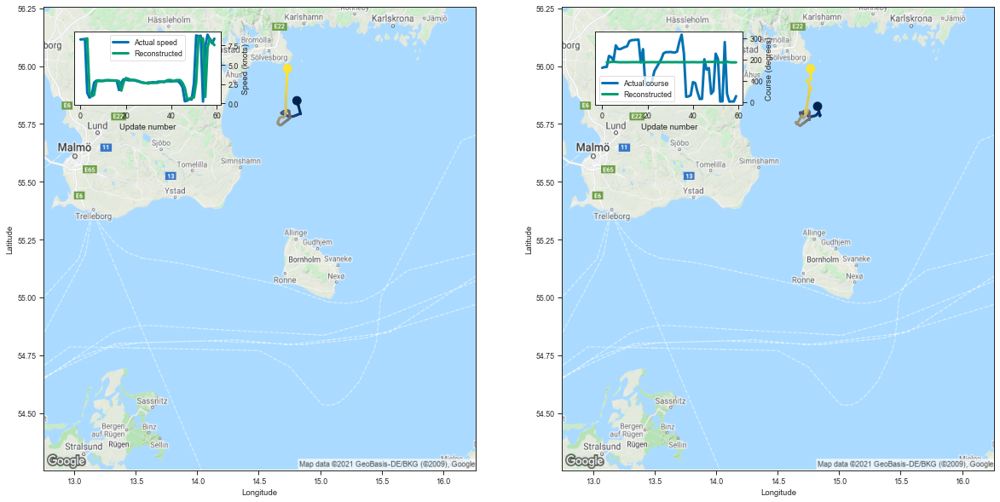

[8.359648704528809, 8.425932884216309, 1.45612633228302, 0.9071742296218872]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
25,25,7292936,266054000,Fishing,144,1344.586548,9.337407
34,34,7237328,266054000,Fishing,144,1343.346191,9.328793
44,44,7135380,266054000,Fishing,144,1325.963867,9.208082
29,29,6787151,265759000,Fishing,143,1314.929688,9.195312
17,17,6685896,265759000,Fishing,143,1306.368286,9.135443
...,...,...,...,...,...,...,...
97,97,7993496,273513600,Fishing,68,-33.701492,-0.495610
91,91,5598936,265750000,Fishing,140,-100.009003,-0.714350
33,33,4352040,261015270,Fishing,113,-80.935844,-0.716246
21,21,19488,211243240,Fishing,110,-80.565918,-0.732417


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n